# Import librarys and Data

In [3]:
#!pip install -r requirements.txt

In [4]:
#import important liberies Important!! usse  python 3.11 or below
import pandas as pd
import pyreadr
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import numpy as np
from tabulate import tabulate
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler, LabelEncoder

In [5]:
# Converting .rData into dataframe
fault_free_training_dict = pyreadr.read_r("data/TEP_FaultFree_Training.RData")
fault_free_testing_dict = pyreadr.read_r("data/TEP_FaultFree_Testing.RData")

faulty_training_dict = pyreadr.read_r("data/TEP_Faulty_Training.RData")
faulty_testing_dict = pyreadr.read_r("data/TEP_Faulty_Testing.RData")

In [6]:
df_ff_training = fault_free_training_dict['fault_free_training']
df_ff_test = fault_free_testing_dict['fault_free_testing']

df_f_training = faulty_training_dict['faulty_training']
df_f_test = faulty_testing_dict['faulty_testing']

In [7]:
# mapp errors to their respective fault numbers
X_dict = {
'XMEAS_1':'A_feed_stream',
'XMEAS_2':'D_feed_stream',
'XMEAS_3':'E_feed_stream',
'XMEAS_4':'Total_fresh_feed_stripper',
'XMEAS_5':'Recycle_flow_into_rxtr',
'XMEAS_6':'Reactor_feed_rate',
'XMEAS_7':'Reactor_pressure',
'XMEAS_8':'Reactor_level',
'XMEAS_9':'Reactor_temp',
'XMEAS_10':'Purge_rate',
'XMEAS_11':'Separator_temp',
'XMEAS_12':'Separator_level',
'XMEAS_13':'Separator_pressure',
'XMEAS_14':'Separator_underflow',
'XMEAS_15':'Stripper_level',
'XMEAS_16':'Stripper_pressure',
'XMEAS_17':'Stripper_underflow',
'XMEAS_18':'Stripper_temperature',
'XMEAS_19':'Stripper_steam_flow',
'XMEAS_20':'Compressor_work',
'XMEAS_21':'Reactor_cooling_water_outlet_temp',
'XMEAS_22':'Condenser_cooling_water_outlet_temp',
'XMEAS_23':'Composition_of_A_rxtr_feed',
'XMEAS_24':'Composition_of_B_rxtr_feed',
'XMEAS_25':'Composition_of_C_rxtr_feed',
'XMEAS_26':'Composition_of_D_rxtr_feed',
'XMEAS_27':'Composition_of_E_rxtr_feed',
'XMEAS_28':'Composition_of_F_rxtr_feed',
'XMEAS_29':'Composition_of_A_purge',
'XMEAS_30':'Composition_of_B_purge',
'XMEAS_31':'Composition_of_C_purge',
'XMEAS_32':'Composition_of_D_purge',
'XMEAS_33':'Composition_of_E_purge',
'XMEAS_34':'Composition_of_F_purge',
'XMEAS_35':'Composition_of_G_purge',
'XMEAS_36':'Composition_of_H_purge',
'XMEAS_37':'Composition_of_D_product',
'XMEAS_38':'Composition_of_E_product',
'XMEAS_39':'Composition_of_F_product',
'XMEAS_40':'Composition_of_G_product',
'XMEAS_41':'Composition_of_H_product',
'XMV_1':'D_feed_flow_valve',
'XMV_2':'E_feed_flow_valve',
'XMV_3':'A_feed_flow_valve',
'XMV_4':'Total_feed_flow_stripper_valve',
'XMV_5':'Compressor_recycle_valve',
'XMV_6':'Purge_valve',
'XMV_7':'Separator_pot_liquid_flow_valve',
'XMV_8':'Stripper_liquid_product_flow_valve',
'XMV_9':'Stripper_steam_valve',
'XMV_10':'Reactor_cooling_water_flow_valve',
'XMV_11':'Condenser_cooling_water_flow_valve',
'XMV_12':'Agitator_speed'
}

# Custom functions

In [8]:
# Compare fault vs normal time series for selected features.
# This help to caputre the differences between faulty and normal segments of the time series data and determine the start of the fault injection.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def plot_fault_vs_normal_segment(
    df_fault: pd.DataFrame,
    df_normal: pd.DataFrame,
    features: list[str],
    point_start: int,
    point_end: int,
    fault_number: int,
    fault_injection_index: int = 160
) -> None:
    """
    Compare fault vs normal time series for selected features.

    Parameters:
    - df_fault: DataFrame with faults (should include faultNumber column).
    - df_normal: Normal (non-faulty) baseline DataFrame.
    - features: List of feature names to compare.
    - point_start: Start index of window.
    - point_end: End index of window (exclusive).
    - fault_number: Fault number to extract from df_fault.
    """
    df_fault = df_fault[df_fault['faultNumber'] == fault_number].reset_index(drop=True)
    df_fault_window = df_fault.iloc[point_start:point_end]
    df_normal_window = df_normal.iloc[point_start:point_end]

    x_range = np.arange(point_start, point_end)
    n_features = len(features)
    fig, axes = plt.subplots(n_features, 1, figsize=(30, 3 * n_features), sharex=True)

    if n_features == 1:
        axes = [axes]

    for i, feature in enumerate(features):
        ax = axes[i]

        y_fault = df_fault_window[feature].values
        y_normal = df_normal_window[feature].values
        
        ax.plot(x_range, y_fault, label=f'Fault {fault_number}', color='red')
        ax.plot(x_range, y_normal, label='Normal', color='black')

        # Median lines
        ax.axhline(np.median(y_normal), color='black', linestyle='--', label='Normal Median')
        ax.axhline(np.median(y_fault), color='red', linestyle='--', label='Fault Median')
        ax.axvline(fault_injection_index, color='green', linestyle='--', linewidth=2, label='Fault Injected')
        # Mark every 5th index
        for x in x_range:
            if x % 5 == 0:
                ax.axvline(x, color='gray', linestyle=':', linewidth=0.5)
                ax.text(
                    x,
                    ax.get_ylim()[1],
                    f"{x}",
                    color='gray',
                    fontsize=8,
                    ha='center',
                    va='bottom',
                    rotation=90,
                    backgroundcolor='white'
                )
        ax.set_ylabel(feature)
        ax.grid(True)
        if i == 0:
            ax.legend(loc='best')
    # Place suptitle before tight_layout to ensure it appears above the plots
    #plt.suptitle(f"Comparison of Fault {fault_number} vs Normal", fontsize=14)
    plt.xlabel("Time Index")
    
    plt.tight_layout()
    plt.show()
    

# # usage example

# simulationRun = 8.0
# df_fault = df_f_training[(df_f_training['simulationRun'] == simulationRun)].reset_index(drop=True)
# df_normal = df_ff_training[(df_ff_training['simulationRun'] == simulationRun)].reset_index(drop=True)


# plot_fault_vs_normal_segment(
#     df_fault=df_fault ,
#     df_normal=df_normal,
#     features=df_f_training.columns[3:],
#     point_start=0,
#     point_end=500,
#     fault_number=4,
#     fault_injection_index=25
# )


In [9]:
# Determine the fault insection data point

# This function will plot the feature time series before and after fault injection
# It will also mark the fault injection point and show median values before and after the injection.
# It is useful for visualizing how features change around the time a fault is injected.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def plot_fault_injection_segment(
    df: pd.DataFrame,
    fault_injection_index: int,
    features: list[str],
    fault_number: int,
    point_start: int = 0,
    point_end: int = 500
) -> None:
    """
    Plot feature time series before and after fault injection.

    Parameters:
    - df: DataFrame containing time series (1 simulation run).
    - fault_injection_index: Time step where fault is injected.
    - features: List of feature names to plot.
    - window: Number of time steps before and after injection to show.
    """
    # Filter only the rows with the selected fault number
    df: pd.DataFrame = df[df['faultNumber'] == fault_number].reset_index(drop=True)

    x_range: np.ndarray = np.arange(point_start, point_end)

    df_window: pd.DataFrame = df.iloc[point_start:point_end]

    n_features: int = len(features)
    fig, axes = plt.subplots(n_features, 1, figsize=(30, 3* n_features), sharex=True)

    if n_features == 1:
        axes = [axes]

    for i, feature in enumerate(features):
        ax = axes[i]
        y = df_window[feature].values
        ax.plot(x_range, y, label=feature, color='black')
        
        # Mark every 5th time index
        for x in x_range:
            if x % 5 == 0:
                ax.axvline(x, color='gray', linestyle=':', linewidth=0.5)
                ax.text(
                    x,
                    ax.get_ylim()[1],
                    f"{x}",
                    color='gray',
                    fontsize=8,
                    ha='center',
                    va='bottom',
                    rotation=90,
                    backgroundcolor='white'
                )


        # Vertical fault injection marker
        ax.axvline(fault_injection_index, color='red', linestyle='--', linewidth=2, label='Fault Injected')
        

        
        # Text showing the time index
        ax.text(
            fault_injection_index,
            ax.get_ylim()[1],
            f"t={fault_injection_index}",
            color='red',
            fontsize=10,
            ha='center',
            va='bottom',
            rotation=0,
            backgroundcolor='white'
        )

        # Median before/after
        before = df.loc[point_start:fault_injection_index - 1, feature]
        after = df.loc[fault_injection_index:point_end - 1, feature]
        before_med = np.median(before)
        after_med = np.median(after)

        ax.axhline(before_med, color='blue', linestyle=':', label='Median Before')
        ax.axhline(after_med, color='green', linestyle=':', label='Median After')

        ax.set_ylabel(feature)
        ax.grid(True)

        if i == 0:
            ax.legend(loc='best')

    plt.xlabel("Time Index")
    plt.suptitle("Feature Response Around Fault Injection", fontsize=14)
    plt.tight_layout()
    plt.show()

# # Usage example
# df_fault = df_f_training[(df_f_training['simulationRun'] == 2.0)].reset_index(drop=True)

# print(len(df_fault))

# plot_fault_injection_segment(
#     df=df_fault,
#     fault_injection_index=160,
#     #features=['xmeas_1', 'xmeas_2', 'xmeas_3', 'xmeas_4', 'xmeas_5', 'xmeas_6'],
#     features=df_fault.columns[3:9],
#     fault_number=1,
#     point_start=1,
#     point_end=500
# )

In [10]:
from typing import Union, List, Dict, Optional
import numpy as np

def compute_mspc_metrics(
    y_true: Union[List[int], np.ndarray],
    y_pred: Union[List[int], np.ndarray]
) -> Dict[str, Optional[float]]:
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    fault_types = np.unique(y_true[y_true > 0])
    ic_indices = np.where(y_true == 0)[0]

    detection_delays = []
    detected_faults = 0
    total_faults = len(fault_types)

    for fault in fault_types:
        fault_indices = np.where(y_true == fault)[0]
        fault_start = fault_indices[0]

        predicted_indices = np.where(y_pred == fault)[0]
        detection_points = predicted_indices[predicted_indices >= fault_start]

        if detection_points.size > 0:
            detected_faults += 1
            delay = detection_points[0] - fault_start
            detection_delays.append(delay)

    detection_rate = detected_faults / total_faults if total_faults > 0 else None
    average_delay = np.mean(detection_delays) if detection_delays else None

    arl1_values = []
    for fault in fault_types:
        fault_indices = np.where(y_true == fault)[0]
        fault_start = fault_indices[0]

        predicted_indices = np.where(y_pred == fault)[0]
        detection_points = predicted_indices[predicted_indices >= fault_start]

        if detection_points.size > 0:
            arl1_values.append(detection_points[0] - fault_start)
    arl1 = np.mean(arl1_values) if arl1_values else None

    # For ARL0 and False Alarm Rate (FAR)
    false_alarm_positions = np.where((y_true == 0) & (y_pred != 0))[0]

    if false_alarm_positions.size > 0:
        # Calculate ARL0 as average gap between false alarms in IC samples
        gaps = np.diff(false_alarm_positions)
        if gaps.size > 0:
            arl0 = np.mean(gaps)
        else:
            arl0 = None
        false_alarm_rate = false_alarm_positions.size / ic_indices.size if ic_indices.size > 0 else None
    else:
        arl0 = None
        false_alarm_rate = 0.0 if ic_indices.size > 0 else None

    return {
        "Detection Rate": detection_rate,
        "Average Delay": average_delay,
        "ARL₁": arl1,
        "ARL₀": arl0,
        "False Alarm Rate": false_alarm_rate,
    }


In [11]:
# Plot confusion matrix

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from tabulate import tabulate
from typing import Union, List

def plot_confusion_matrix(
    y_true: Union[List[int], np.ndarray],
    y_pred: Union[List[int], np.ndarray],
    title: str
) -> None:
    cm = confusion_matrix(y_true, y_pred, normalize='true')
    num_classes: int = cm.shape[0]

    width: float = max(6, num_classes * 0.8)
    height: float = max(4, num_classes * 0.6)

    f, ax = plt.subplots(figsize=(width, height))
    sns.heatmap(cm, annot=True, cmap='Blues', ax=ax)
    ax.set_title(title)
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.set_ylim(num_classes, 0)
    plt.tight_layout()
    plt.show()

In [12]:
# Plot combined ARL₁ and ARL₀ bar plots for all models

def plot_combined_arl_bars(arl_dfs: dict) -> None:
    """
    Plot combined ARL₁ and ARL₀ bar plots for all models.

    Parameters:
        arl_dfs (dict): A dictionary where keys are model names and values are DataFrames
                        with columns ['Fault', 'ARL0', 'ARL1'].
    """
    n_models = len(arl_dfs)
    faults = arl_dfs[next(iter(arl_dfs))]['Fault'].astype(str)

    fig, axes = plt.subplots(2, n_models, figsize=(5 * n_models, 10), sharex='col')

    if n_models == 1:
        axes = np.array([[axes[0]], [axes[1]]])  # Ensure axes is 2D if only one model

    for col, (model_name, arl_df) in enumerate(arl_dfs.items()):
        # ARL1 plot (top row)
        axes[0, col].bar(faults, arl_df['ARL1'], color='salmon')
        axes[0, col].set_title(f'{model_name}: ARL1 per Fault')
        axes[0, col].set_ylabel('ARL1')
        axes[0, col].tick_params(axis='x', rotation=45)

        # ARL0 plot (bottom row)
        axes[1, col].bar(faults, arl_df['ARL0'], color='skyblue')
        axes[1, col].set_title(f'{model_name}: ARL0 per Fault')
        axes[1, col].set_xlabel('Fault')
        axes[1, col].set_ylabel('ARL0')
        axes[1, col].tick_params(axis='x', rotation=45)

    plt.suptitle('ARL1 and ARL0 per Fault for All Models', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


In [13]:
# Plot_arl_bars_per_model

def plot_arl_bars_per_model(arl_dfs: dict) -> None:
    """
    Plot ARL₁ and ARL₀ side-by-side bars for each fault per model,
    with one plot per model.

    Parameters:
        arl_dfs (dict): Dict of model name → DataFrame with ['Fault', 'ARL0', 'ARL1']
    """
    n_models = len(arl_dfs)
    for model_name, arl_df in arl_dfs.items():
        faults = arl_df['Fault'].astype(str)
        x = np.arange(len(faults))
        width = 0.35

        fig, ax = plt.subplots(figsize=(12, 6))
        bars_arl1 = ax.bar(x - width/2, arl_df['ARL1'], width, label='ARL1', color='salmon')
        bars_arl0 = ax.bar(x + width/2, arl_df['ARL0'], width, label='ARL0', color='skyblue')

        ax.set_xticks(x)
        ax.set_xticklabels(faults, rotation=45)
        ax.set_xlabel('Fault')
        ax.set_ylabel('Average Run Length')
        ax.set_title(f'{model_name}: ARL1 and ARL0 per Fault')
        ax.legend()
        ax.grid(axis='y', linestyle='--', alpha=0.7)

        plt.tight_layout()
        plt.show()


In [14]:
# Plot_combined_detection_delay
def plot_combined_detection_delay(delay_tables: dict) -> None:
    combined_df = pd.concat(
        [df.assign(Model=model) for model, df in delay_tables.items()],
        ignore_index=True
    )

    plt.figure(figsize=(14, 6))
    sns.barplot(data=combined_df, x='Fault', y='First Detection Delay', hue='Model')
    plt.title('First Correct Detection Delay per Fault for All Models')
    plt.xlabel('Fault')
    plt.ylabel('First Detection Delay (samples)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [15]:
# # Compute_arl_per_fault
# import numpy as np
# import pandas as pd
# from typing import Union, List




# def compute_arl_per_fault(
#     y_true: Union[List[int], np.ndarray],
#     y_pred: Union[List[int], np.ndarray],
#     debug_fault: int = 9999
# ) -> pd.DataFrame:
#     """
#     Compute Average Run Length (ARL) metrics for each fault in MSPC.

#     ARL0: Average run length of normal (0) samples between false alarms (predicted fault while true is 0).
#     ARL1: Average run length of fault samples before first correct detection,
#           averaged over all fault events per fault type.

#     Parameters:
#         y_true: 0 = normal, >0 = fault types
#         y_pred: 0 = normal, >0 = predicted faults

#     Returns:
#         pd.DataFrame with columns ['Fault', 'ARL0', 'ARL1']
#     """
#     y_true = np.array(y_true)
#     y_pred = np.array(y_pred)

#     faults = np.unique(y_true[y_true > 0])
#     normal_mask = y_true == 0

#     false_alarm_indices = np.where((normal_mask) & (y_pred > 0))[0]

#     run_lengths = []
#     prev_index = -1

#     for fa_idx in false_alarm_indices:
#         run_lengths.append(fa_idx - prev_index - 1)
#         prev_index = fa_idx

#     normal_indices = np.where(normal_mask)[0]
#     if normal_indices.size > 0:
#         last_normal_idx = normal_indices[-1]
#         if prev_index < last_normal_idx:
#             run_lengths.append(last_normal_idx - prev_index)

#     arl0 = np.mean(run_lengths) if run_lengths else None

#     def find_fault_events(y: np.ndarray, fault_label: int) -> List[np.ndarray]:
#         fault_indices = np.where(y == fault_label)[0]
#         if fault_indices.size == 0:
#             return []
#         events = []
#         event = [fault_indices[0]]
#         for i in range(1, len(fault_indices)):
#             if fault_indices[i] == fault_indices[i - 1] + 1:
#                 event.append(fault_indices[i])
#             else:
#                 events.append(np.array(event))
#                 event = [fault_indices[i]]
#         events.append(np.array(event))
#         return events

#     arl1_list = []
#     for fault in faults:
#         events = find_fault_events(y_true, fault)
#         delays = []
#         if fault == debug_fault:  # Assuming 9999 is the fault number for debugging
#             print(f"\nDEBUG: Fault {fault}")
#             print(f"  Fault Events: {[e.tolist() for e in events]}")
#         for event_indices in events:
#             correct_detect = [i for i in event_indices if y_pred[i] == fault]
#             if fault == debug_fault:
#                 print(f"  Event indices: {event_indices.tolist()}")
#                 print(f"  Correct detections at: {correct_detect}")
#             if not correct_detect:
#                 continue
#             first_detect = correct_detect[0]
#             delay = first_detect - event_indices[0]
#             if fault == debug_fault:
#                 print(f"  First detection at index {first_detect}, delay = {delay}")
#             delays.append(delay)

#         arl1 = np.mean(delays) if delays else None
#         if fault == debug_fault:
#             print(f"  ARL1 = {arl1} from delays {delays}")
#         arl1_list.append((fault, arl1))

#     rows = []
#     for fault, arl1 in arl1_list:
#         rows.append({'Fault': fault, 'ARL0': arl0, 'ARL1': arl1})

#     return pd.DataFrame(rows)





In [16]:
# compute_arl_per_fault

from typing import Union, List
import numpy as np
import pandas as pd


def compute_arl_per_fault(
    y_true: Union[List[int], np.ndarray],
    y_pred: Union[List[int], np.ndarray]
) -> pd.DataFrame:
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)

    faults = np.unique(y_true[y_true > 0])
    results = []

    # Helper: find continuous segments for a fault
    def find_segments(arr: np.ndarray, fault: int):
        segments = []
        start = None
        for i, val in enumerate(arr):
            if val == fault and start is None:
                start = i
            elif val != fault and start is not None:
                segments.append((start, i))
                start = None
        if start is not None:
            segments.append((start, len(arr)))
        return segments

    for fault in faults:
        # ARL0: false alarms on normal samples (y_true==0) predicted as fault
        false_alarm_idxs = np.where((y_true == 0) & (y_pred == fault))[0]
        if len(false_alarm_idxs) < 2:
            arl0 = float('inf')
        else:
            gaps = np.diff(false_alarm_idxs) - 1
            arl0 = np.mean(gaps)

        # ARL1: detection delay in fault segments
        segments = find_segments(y_true, fault)
        delays = []
        for start, end in segments:
            segment_preds = y_pred[start:end]
            # Find first index where predicted correctly (y_pred == fault)
            correct_indices = np.where(segment_preds == fault)[0]
            if len(correct_indices) == 0:
                delay = end - start
            else:
                delay = correct_indices[0]
            delays.append(delay)
        arl1 = np.mean(delays) if delays else float('inf')

        results.append({"Fault": fault, "ARL0": arl0, "ARL1": arl1})

    return pd.DataFrame(results).sort_values("Fault").reset_index(drop=True)


# # Test example data from previous step
# y_true = np.array([
#     0, 0, 2, 2, 2, 0,
#     1, 1,
#     0, 0,
#     3, 3, 3, 3,
#     0, 0, 0, 0, 0,
#     2, 2,
# ])

# y_pred = np.array([
#     0, 2, 0, 2, 2, 0,
#     0, 0,
#     1, 0,
#     0, 3, 0, 3,
#     2, 0, 3, 0, 0,
#     2, 2,
# ])

# df_result = compute_arl_per_fault(y_true, y_pred)
# print(df_result)


In [17]:
# Print per model tables for ARL₁ and First Detection Delay
def print_per_model_tables() -> None:
    for model_name in arl_tables:
        print(f"\nARL per Fault – {model_name}")
        print(tabulate(arl_tables[model_name], headers='keys', tablefmt='fancy_grid', showindex=False, floatfmt=".2f"))

        print(f"\nFirst Detection Delay per Fault – {model_name}")
        print(tabulate(delay_tables[model_name], headers='keys', tablefmt='fancy_grid', showindex=False, floatfmt=".2f"))

def print_summary_table() -> None:
    results_df = pd.DataFrame(models_results)
    print(tabulate(results_df.sort_values(by='F1-Score', ascending=False),
                   headers='keys', tablefmt='fancy_grid',
                   showindex=False, floatfmt=".4f"))
def plot_all_confusion_matrices(model_preds: dict[str, tuple]) -> None:
    for name, (y_true, y_pred) in model_preds.items():
        plot_confusion_matrix(y_true, y_pred, f"{name} Confusion Matrix")

def plot_models_metrics_compareing() -> None:
    results_df = pd.DataFrame(models_results)
    #metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score', 'Detection Rate', 'Avg Delay', 'ARL₁', 'ARL₀', 'False Alarm Rate']
    metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score', 'False Alarm Rate']
    melted_df = results_df.melt(id_vars='Model', value_vars=metrics, var_name='Metric', value_name='Score')

    plt.figure(figsize=(16, 6))
    ax = sns.barplot(data=melted_df, x='Metric', y='Score', hue='Model')
    ax.grid(axis='y', linestyle='--', linewidth=0.9, alpha=0.9)
    plt.title('Model Comparison Across Metrics')
    plt.ylim(0, 1.0)
    plt.legend(title='Model', bbox_to_anchor=(1.01, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


In [18]:
# Compute_first_detection_delay
import numpy as np
import pandas as pd
from typing import Union, List

def compute_first_detection_delay(
    y_true: Union[List[int], np.ndarray],
    y_pred: Union[List[int], np.ndarray]
) -> pd.DataFrame:
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    fault_labels = sorted(np.unique(y_true[y_true > 0]))
    results = []

    for fault in fault_labels:
        fault_mask = (y_true == fault)
        fault_indices = np.where(fault_mask)[0] # Get indices of fault samples
        if len(fault_indices) == 0:
            delay = None
            print("No fault samples.")
        else:
            start_index: int = fault_indices[0] # Get the first index of the fault
            detection_indices = np.where((y_pred == fault) & (np.arange(len(y_pred)) >= start_index))[0] # Get indices where the prediction matches the fault and is after the start index
            delay = detection_indices[0] - start_index if len(detection_indices) > 0 else None

        results.append({
            'Fault': fault,
            'First Detection Delay': delay if (delay is not None and delay >= 0) else np.nan,
        })

    return pd.DataFrame(results)


# Prepare data

In [19]:
# Fault Injection Point and Skipped Faults

target_variable_column_name = 'faultNumber'
columns_to_remove = ['simulationRun', 'sample']
skiped_faults= []

df_f_train_skipped_faults = df_f_training[~df_f_training[target_variable_column_name].isin(skiped_faults)].reset_index(drop=True)
df_f_test_skipped_faults = df_f_test[~df_f_test[target_variable_column_name].isin(skiped_faults)].reset_index(drop=True)

df_training_concated = pd.concat([df_ff_training, df_f_train_skipped_faults])
df_test_concated = pd.concat([df_ff_test,df_f_test_skipped_faults])

In [20]:
# Reduce Training and test data for simplicity during development and testing
fault_injection_point = 20

# Reduce the *train* data to simulation runs between 1 and 10, and samples greater than fault_injection_point = 20
reduced_data_train =df_training_concated[(df_training_concated['simulationRun'] >= 1 ) & (df_training_concated['simulationRun'] <4 ) & (df_training_concated['sample'] > fault_injection_point)]

# Reduce the *test* data to simulation runs between 1 and 3, and samples greater than 20
reduced_data_test = df_test_concated[(df_test_concated['simulationRun'] > 10 ) & (df_test_concated['simulationRun'] < 13) & (df_test_concated['sample'] > fault_injection_point)]

print(f"Reduced train data shape: {reduced_data_train.shape}")
print(f"Reduced test data shape: {reduced_data_test.shape}")

Reduced train data shape: (30240, 55)
Reduced test data shape: (39480, 55)


In [21]:
# Prepare data

prepared_data_train = reduced_data_train.drop(columns=columns_to_remove, axis=1)
prepared_data_test = reduced_data_test.drop(columns=columns_to_remove, axis=1)

# Standardize the data: It centers the data around 0 and scales it based on standard deviation.
sc = StandardScaler()
sc.fit(prepared_data_train.drop(columns=[target_variable_column_name], axis=1))

# Set the features and target variable for training
x_train = sc.transform(prepared_data_train.drop(columns=[target_variable_column_name], axis=1))
Y = reduced_data_train[target_variable_column_name]

# Encode the target variable: -LabelEncoder() Takes a list/array of categorical labels (e.g., ['shift', 'trend', 'none']), -Assigns a unique integer to each category (e.g., ['none' → 0, 'shift' → 1, 'trend' → 2]), -Returns a NumPy array of integers corresponding to the original labels
le = LabelEncoder()
y_labeled_train = le.fit_transform(Y)

# Set the features and target variable for testing
x_test = sc.transform(prepared_data_test.drop(columns=[target_variable_column_name], axis=1))
Y_test = reduced_data_test[target_variable_column_name]

# Encode the target variable for testing
y_labeled_test = le.fit_transform(Y_test)

# One-hot encode the target variable
encoder = OneHotEncoder(sparse_output=False)
Y_reshabed = reduced_data_train[target_variable_column_name].to_numpy().reshape(-1, 1)
y_one_hot_vector_enc_train= encoder.fit_transform(Y_reshabed)
Y_test_reshabed = reduced_data_test[target_variable_column_name].to_numpy().reshape(-1, 1)
y_one_hot_vector_enc_test = encoder.transform(Y_test_reshabed)


In [22]:
reduced_data_test

,faultNumber,simulationRun,sample,xmeas_1,xmeas_2,xmeas_3,xmeas_4,xmeas_5,xmeas_6,xmeas_7,...,xmv_2,xmv_3,xmv_4,xmv_5,xmv_6,xmv_7,xmv_8,xmv_9,xmv_10,xmv_11
9620,0,11.0,21,0.30373,3670.7,4500.2,9.2164,27.093,42.133,2702.8,...,53.415,29.909,61.532,22.112,41.225,38.221,41.589,47.354,41.471,21.267
9621,0,11.0,22,0.30275,3679.4,4484.1,9.2707,27.081,42.726,2699.7,...,53.607,30.005,62.863,21.996,40.866,34.899,48.526,47.546,40.811,16.163
9622,0,11.0,23,0.32900,3641.4,4478.3,9.2669,26.973,42.136,2701.6,...,53.953,32.331,61.226,22.292,41.982,39.044,48.899,47.232,41.004,18.998
9623,0,11.0,24,0.32846,3642.5,4470.2,9.2582,26.475,42.134,2702.8,...,54.050,32.384,63.030,22.214,41.637,40.747,44.826,47.412,41.236,18.497
9624,0,11.0,25,0.30146,3648.4,4457.2,9.3739,26.930,42.328,2700.7,...,53.872,29.327,62.808,22.256,40.317,39.489,48.660,47.546,41.933,19.502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230395,20,12.0,956,0.26234,3650.1,4534.3,9.3109,27.186,42.146,2704.1,...,53.246,25.761,60.920,17.118,42.580,36.652,47.203,48.082,41.258,17.619
230396,20,12.0,957,0.30984,3661.4,4507.0,9.3411,26.834,42.459,2706.0,...,53.567,30.248,60.734,16.181,42.577,37.844,46.319,48.108,39.957,18.365
230397,20,12.0,958,0.31065,3663.6,4513.0,9.3092,27.112,42.530,2705.3,...,53.494,30.168,59.971,15.196,42.724,37.237,49.305,48.032,41.490,19.229
230398,20,12.0,959,0.30873,3642.9,4487.0,9.2055,27.155,41.977,2709.1,...,54.276,30.058,60.816,14.416,41.431,33.220,39.968,48.162,40.368,19.814


In [23]:
# Standardize the data for fault training data or EDA
sc = StandardScaler()
sc.fit(df_f_training.drop(columns=[target_variable_column_name], axis=1))
x_f_train = sc.transform(df_f_training.drop(columns=[target_variable_column_name], axis=1))
y_f_labeled_train = df_f_training[target_variable_column_name].to_numpy()
le = LabelEncoder()
y_f_labeled_train = le.fit_transform(y_f_labeled_train)

sc = StandardScaler()
sc.fit(df_ff_training.drop(columns=[target_variable_column_name], axis=1))
x_ff_train = sc.transform(df_ff_training.drop(columns=[target_variable_column_name], axis=1))
y_ff_labeled_train = df_ff_training[target_variable_column_name].to_numpy()
le = LabelEncoder()
y_ff_labeled_train = le.fit_transform(y_ff_labeled_train)

# Exploratory Data Analysis (EDA)

**The TEP variables (columns 4 to 55) were sampled every 3 minutes for a total duration of 25 hours and 48 hours respectively.
The faults were introduced 1 hour into the Faulty Training
and 8 hours into Faulty Testing datasets**

In [24]:
# describe_dataframes function to generate summary report for multiple DataFrames

from typing import Dict, Any
import pandas as pd


def describe_dataframes(dataframes: Dict[str, pd.DataFrame],
                        target_column: str) -> pd.DataFrame:
    """
    Generate summary report for multiple DataFrames.

    Args:
        dataframes: A dictionary with keys as descriptive names and values as pandas DataFrames.
        target_column: Name of the target variable in the DataFrames.

    Returns:
        A summary DataFrame containing description of each input DataFrame.
    """
    summary_rows: list[Dict[str, Any]] = []

    for name, df in dataframes.items():
        if target_column not in df.columns:
            raise ValueError(
                f"Target column '{target_column}' not found in '{name}' DataFrame."
            )

        input_columns = [col for col in df.columns if col != target_column]
        input_df = df[input_columns]

        summary_rows.append({
            'name':
            name,
            'shape':
            df.shape,
            'target':
            target_column,
            'target_unique_values':
            df[target_column].nunique(),
            'target_classes':
            sorted(df[target_column].unique().tolist()),
            'input_columns':
            input_columns,
            'input_range_min':
            input_df.min(numeric_only=True).to_dict(),
            'input_range_max':
            input_df.max(numeric_only=True).to_dict()
        })

    return pd.DataFrame(summary_rows)


report = describe_dataframes(
    {
        'df_ff_training': df_ff_training,
        'df_ff_test': df_ff_test,
        'df_f_training': df_f_training,
        'df_f_test': df_f_test
    },
    target_column='faultNumber'
)

print(tabulate(report, headers='keys', tablefmt='grid', showindex=False))


+----------------+---------------+-------------+------------------------+-------------------------------------------------------------------------+-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [25]:
# Summary of Simulation Runs and Faults
import pandas as pd

# Collect rows
report_rows: list[dict[str, int | str]] = []

def summarize_dataset(df: pd.DataFrame, dataset_name: str) -> None:
    grouped = df.groupby('simulationRun')

    for sim_run, group in grouped:
        fault_count: int = group['faultNumber'].nunique()
        row_count: int = len(group)

        report_rows.append({
            'simulationRun': sim_run,
            'dataset': dataset_name,
            'rowCountPerRun': row_count,
            'numberOfFaultPerSimulationRun': fault_count,
            'rowCountPerFault': row_count // fault_count if fault_count > 0 else 0
        })

# Summarize both
summarize_dataset(df_f_training, 'df_f_training')
summarize_dataset(df_ff_training, 'df_ff_training')

# Create full DataFrame
full_df: pd.DataFrame = pd.DataFrame(report_rows)

# Group if rows are identical for each dataset
summary_df: pd.DataFrame = (
    full_df
    .groupby(['dataset', 'rowCountPerRun', 'numberOfFaultPerSimulationRun', 'rowCountPerFault'])
    .agg(numRuns=('simulationRun', 'nunique'))
    .reset_index()
    .sort_values(by='dataset')
)

# Display
print("Summary of Simulation Runs and Faults:")
print("Dont forget df_ff_training have no faults, its always have value 0, so the number of distinct Fault PerSimulation Run will always be 1")
print()

print(tabulate(summary_df, headers='keys', tablefmt='grid', showindex=False)   )

Summary of Simulation Runs and Faults:
Dont forget df_ff_training have no faults, its always have value 0, so the number of distinct Fault PerSimulation Run will always be 1

+----------------+------------------+---------------------------------+--------------------+-----------+
| dataset        |   rowCountPerRun |   numberOfFaultPerSimulationRun |   rowCountPerFault |   numRuns |
+================+==================+=================================+====================+===========+
| df_f_training  |            10000 |                              20 |                500 |       500 |
+----------------+------------------+---------------------------------+--------------------+-----------+
| df_ff_training |              500 |                               1 |                500 |       500 |
+----------------+------------------+---------------------------------+--------------------+-----------+


In [26]:
des = df_ff_training.iloc[:,3:].describe()
cal = des.iloc[1:3,:].T
cal["variance"] = cal["std"]**2
cal.head()

,mean,std,variance
xmeas_1,0.250482,0.030873,0.000953
xmeas_2,3663.785706,34.006357,1156.432346
xmeas_3,4508.819790,39.215420,1537.849196
xmeas_4,9.347101,0.085721,0.007348
xmeas_5,26.902196,0.211485,0.044726


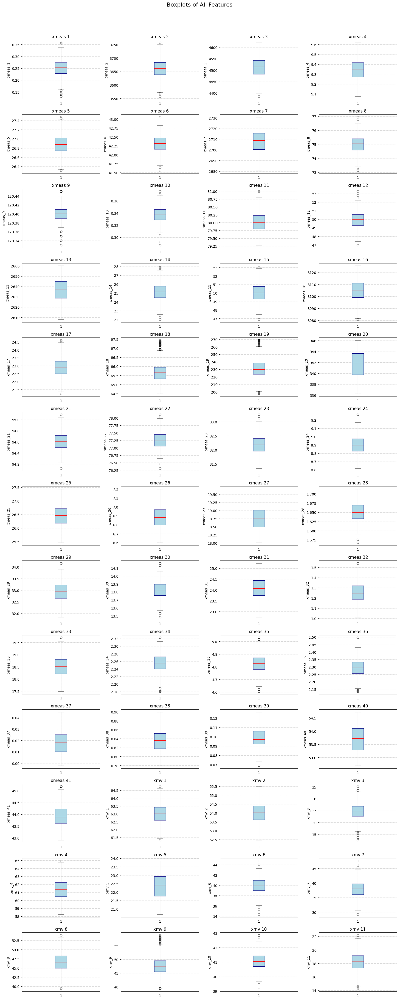

In [27]:
# Plotting boxplots for all features 


faultNumber=3
simulationRun = 10
df_selected_f_data = df_f_training[(df_f_training['faultNumber'] == faultNumber) & (df_f_training['simulationRun'] == simulationRun)]
df_select_ff_data = df_ff_training[(df_ff_training['faultNumber'] == 0) & (df_ff_training['simulationRun'] == simulationRun)]


used_data = df_select_ff_data

feature_columns = df_ff_training.columns[3:]
num_features = len(feature_columns)

# Define the number of rows and columns for the subplots in the grid
num_cols = min(4, num_features)  # Maximum of 4 columns
num_rows = int(np.ceil(num_features / num_cols))
fig, axes = plt.subplots(num_rows, num_cols, figsize=(4 * num_cols, 3 * num_rows))
fig.suptitle("Boxplots of All Features", fontsize=16, y=1.02)

for i, col in enumerate(feature_columns):
    row_index = i // num_cols
    col_index = i % num_cols
    ax = axes[row_index, col_index]

    ax.boxplot(used_data[col], patch_artist=True,
           boxprops=dict(facecolor='lightblue', color='navy'),
           medianprops=dict(color='red'),
           whiskerprops=dict(color='gray'),
           capprops=dict(color='gray'),
           flierprops=dict(marker='o', color='darkorange', alpha=0.5))
    
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_ylabel(col)
    #ax.set_xticklabels([col], rotation=45)
    ax.set_title(col.replace("_"," "))


for i in range(num_features, num_rows * num_cols):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()
plt.show()

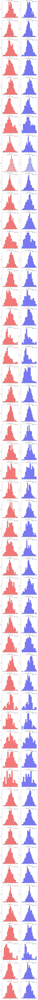

In [28]:
# Plotting distribution of selected features in f and ff beside each other to compare fault vs normal

faultNumber=15
simulationRun = 1
df_selected_f_data = df_f_training[(df_f_training['faultNumber'] == faultNumber) & (df_f_training['simulationRun'] == simulationRun)]
df_select_ff_data = df_ff_training[(df_ff_training['faultNumber'] == 0) & (df_ff_training['simulationRun'] == simulationRun)]

# plotting distribution of selected features f and ff beside each other to compare fault vs normal
# selected features to plot
#selected_features = ['xmeas_1', 'xmeas_2']
selected_features = df_selected_f_data.columns[3:]  # Select features from index 3 to the end
# Create a figure with subplots for each selected feature
fig, axes = plt.subplots(len(selected_features), 2, figsize=(12, 6 * len(selected_features)))
for i, feature in enumerate(selected_features):
    # Plotting the faulty data gaussian distribution
    sns.histplot(df_selected_f_data[feature], kde=True, ax=axes[i, 0], color='red', label='Faulty Data')
    axes[i, 0].set_title(f'Faulty Data - {feature}')
    axes[i, 0].set_xlabel(feature)
    axes[i, 0].set_ylabel('Density')            
    axes[i, 0].legend()
    # Plotting the fault-free data gaussian distribution
    sns.histplot(df_select_ff_data[feature], kde=True, ax=axes[i,
    1], color='blue', label='Fault-Free Data')
    axes[i, 1].set_title(f'Fault-Free Data - {feature}')
    axes[i, 1].set_xlabel(feature)
    axes[i, 1].set_ylabel('Density')
    axes[i, 1].legend()
plt.tight_layout()
plt.show()

     

In [29]:
# Visualize class separation and structure in high-dimensional process data using t-SNE embedding to 2D.

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

def plot_tsne_visualization(x_f_train: np.ndarray, y_f_labeled_train: np.ndarray, step: int = 50) -> None:
    """
    Visualize class separation and structure in high-dimensional process data using t-SNE embedding to 2D.

    Input:
        x_f_train: High-dimensional feature matrix (e.g., 54 dimensions).
        y_f_labeled_train: 1D label array corresponding to x_f_train.
        step: Downsampling factor to reduce computational load (default=50).

    Output:
        A 2D scatter plot showing t-SNE projection colored and styled by labels.
    """

    # Downsample the data to reduce computation
    x_down = x_f_train[::step, :]
    y_label = y_f_labeled_train[::step]

    # Apply t-SNE to project high-dimensional data into 2D space
    x_embedded = TSNE(n_components=2, learning_rate='auto', init='random').fit_transform(x_down)

    # Create a scatter plot of the 2D embedded data
    f, ax = plt.subplots(figsize=(10, 6))
    sns.scatterplot(
        x=x_embedded[:, 0],
        y=x_embedded[:, 1],
        hue=y_label,
        style=y_label,
        palette="bright",
        edgecolor='black'
    )
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.title('t-SNE Visualization of Labeled Data')
    plt.show()

# plot_tsne_visualization(x_f_train, y_f_labeled_train)  # Uncomment to run t-SNE visualization (heavy- take time)


10000


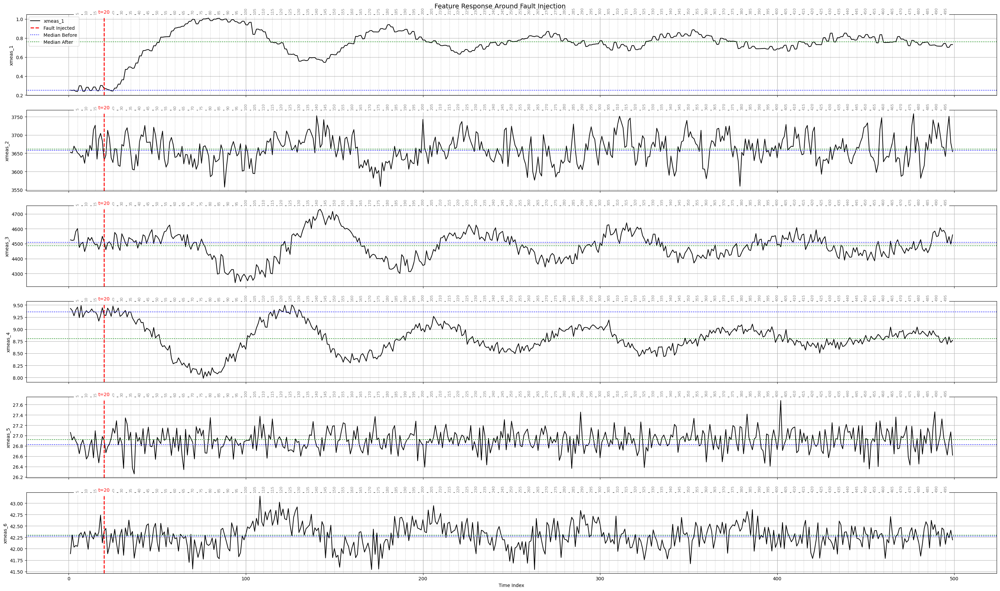

In [30]:
# Determine the fault insection data point

df_fault = df_f_training[(df_f_training['simulationRun'] == 2.0)].reset_index(drop=True)

print(len(df_fault))

plot_fault_injection_segment(
    df=df_fault,
    fault_injection_index=fault_injection_point,
    #features=['xmeas_1', 'xmeas_2', 'xmeas_3', 'xmeas_4', 'xmeas_5', 'xmeas_6'],
    features=df_fault.columns[3:9],
    fault_number=1,
    point_start=1,
    point_end=500
)

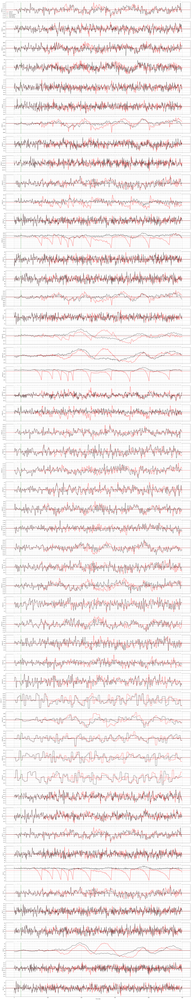

In [31]:
# Compare fault vs normal time series for selected features.
# This help to caputre the differences between faulty and normal segments of the time series data and determine the start of the fault injection.

simulationRun = 8.0
df_fault = df_f_training[(df_f_training['simulationRun'] == simulationRun)].reset_index(drop=True)
df_normal = df_ff_training[(df_ff_training['simulationRun'] == simulationRun)].reset_index(drop=True)


plot_fault_vs_normal_segment(
    df_fault=df_fault,
    df_normal=df_normal,
    features=df_f_training.
    columns[3:],  # Select all features, which strats from index 3
    point_start=0,
    point_end=500,
    fault_number=20,
    fault_injection_index=fault_injection_point)


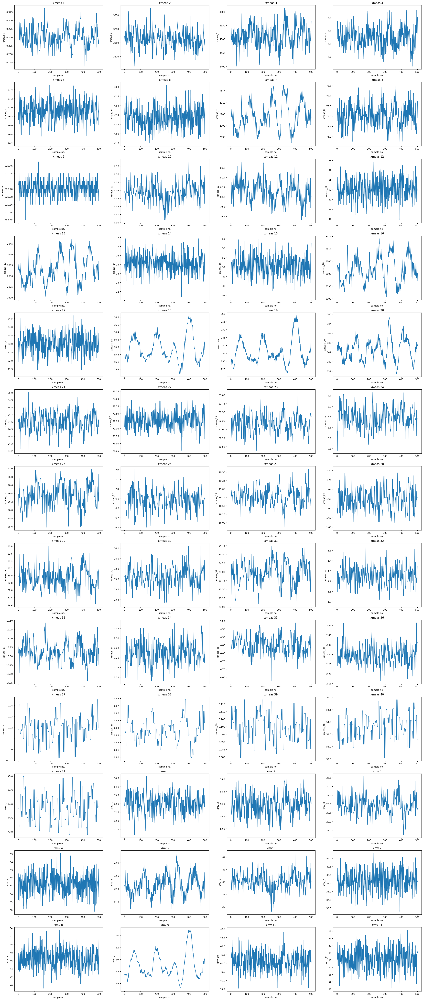

In [32]:
# Plotting Training Data for Simulation Run 1 and Fault Number 0
df_data_to_plot = df_ff_training[ (df_ff_training['faultNumber']==0) & (df_ff_training['simulationRun']==1) ]

feature_columns = df_normal.columns[3:]
num_features = len(feature_columns)

# Define the number of rows and columns for the subplots
num_cols = min(4, num_features)  # Maximum of 4 columns
num_rows = int(np.ceil(num_features / num_cols))
size_multiplier = 2  # Adjust this value to change the size of the subplots
# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(4 * num_cols * size_multiplier, 3 * num_rows * size_multiplier))

for i, col in enumerate(feature_columns):
    # Determine the row and column index (position) for the subplot in the grid
    row_index = i // num_cols
    col_index = i % num_cols
    ax = axes[row_index, col_index]

    ax.plot(df_data_to_plot['sample'], df_data_to_plot[col])
    ax.set_xlabel('sample no.')
    ax.set_ylabel(col)
    ax.set_title(col.replace("_", " "))

for i in range(num_features, num_rows * num_cols):
    fig.delaxes(axes.flatten()[i])

#plt.tight_layout()
#plt.show()


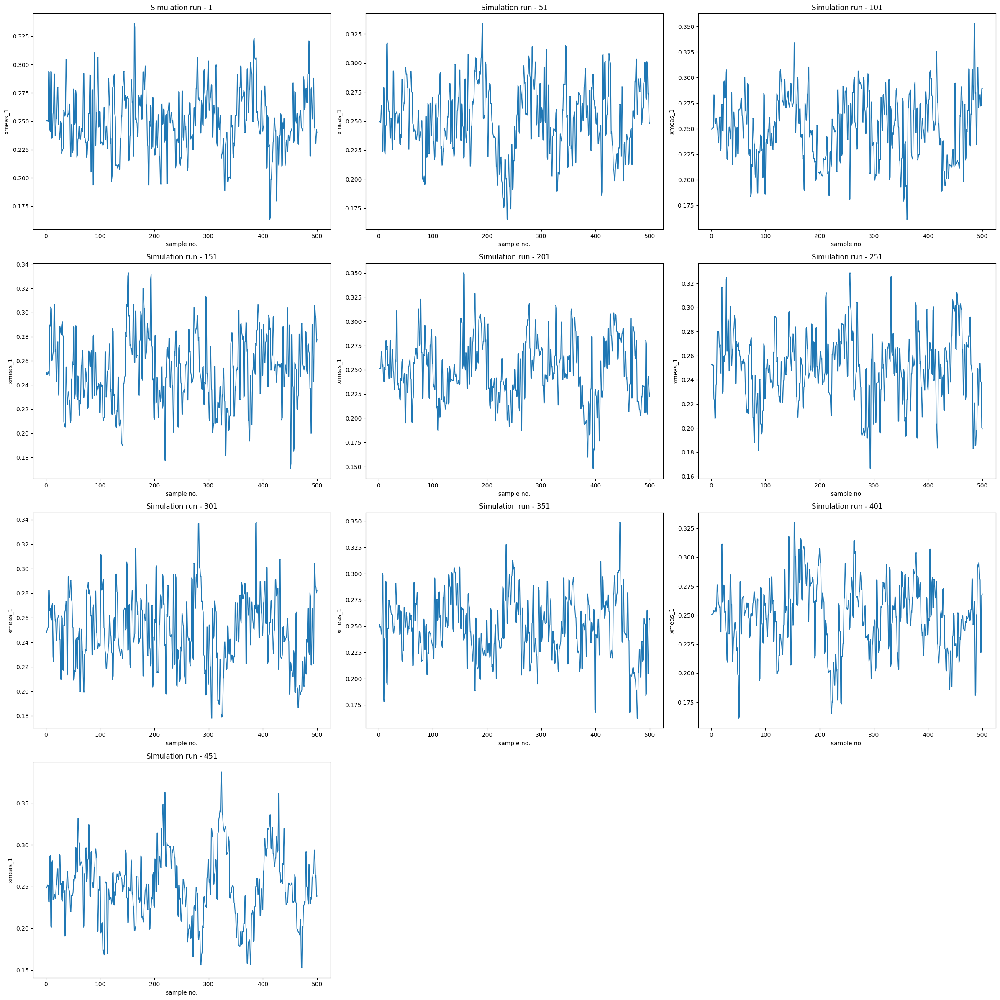

In [33]:
# Plotting a selected feature against sample numbers for multiple simulation runs and no faults

# selected column to plot # Uncomment the column you want to plot
#col = 'A_feed_stream'
col = 'xmeas_1'

# Define the simulation runs to plot
simRuns = np.arange(1, 500, 50)
num_simRuns = len(simRuns)

# Define the number of rows and columns for the subplots in the grid
num_cols = min(3, num_simRuns)  # Maximum of 2 columns
num_rows = int(np.ceil(num_simRuns / num_cols))
size_multiplier = 2  # Adjust this value to change the size of the subplots
# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(4 * num_cols * size_multiplier, 3 * num_rows * size_multiplier))

for i, simRun in enumerate(simRuns):
    pp = df_ff_training[(df_ff_training['faultNumber'] == 0) & (df_ff_training['simulationRun'] == simRun)]
    row_index = i // num_cols
    col_index = i % num_cols
    ax = axes[row_index, col_index]
    ax.plot(pp['sample'], pp[col])
    ax.set_xlabel('sample no.')
    ax.set_ylabel(col)
    ax.set_title(f'Simulation run - {simRun}')

# Remove any empty subplots
for i in range(num_simRuns, num_rows * num_cols):
    fig.delaxes(axes.flatten()[i])

plt.tight_layout()

plt.show()

### TODO
- also show the features as time series to compare the similarty or the position of outliner
- create code the use partial correlaltion to match features the are partly similer to the same time points
- compare with mutual information algorithem

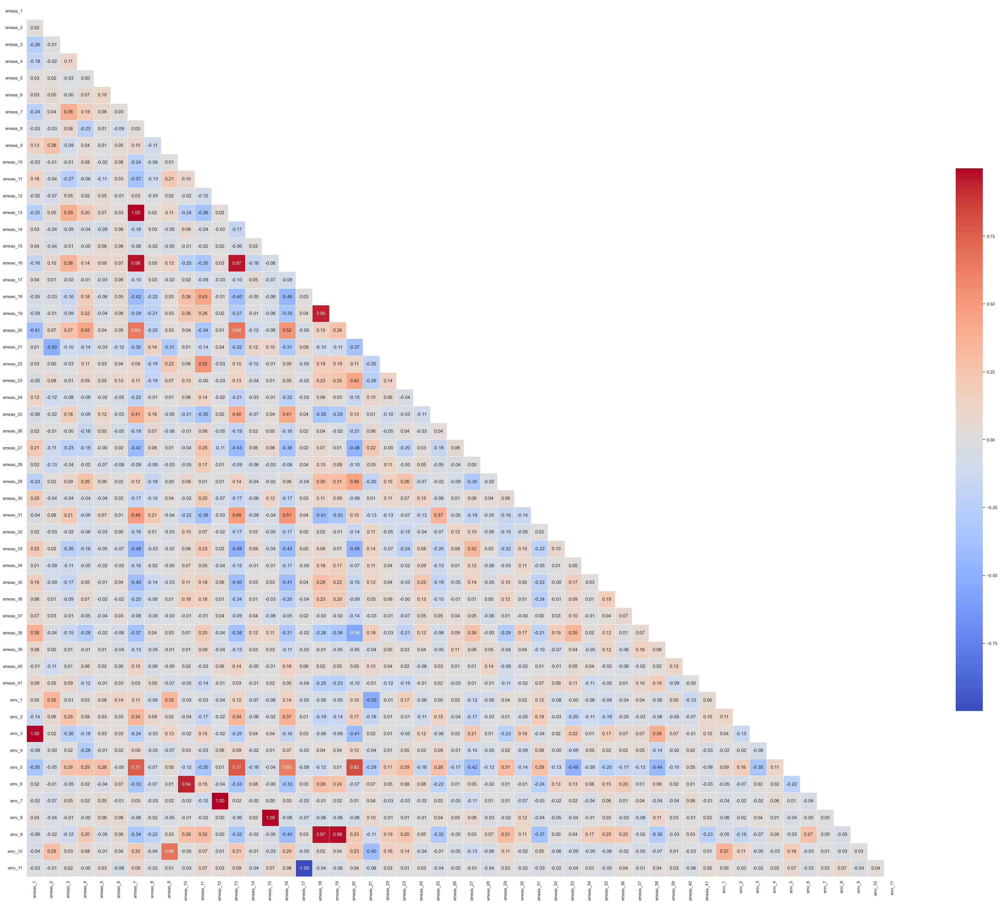

In [34]:
# Plotting the correlation matrix of the features

# Load the data into a pandas DataFrame
data = df_ff_training[df_ff_training['simulationRun']==1].iloc[:,3:]

# Calculate the correlation matrix
corr = data.corr()

# Create a heatmap with annotations
sns.set_theme(style='white')
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(50, 50))
sns.heatmap(corr, mask=mask, cmap='coolwarm', annot=True, fmt='.2f',
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()

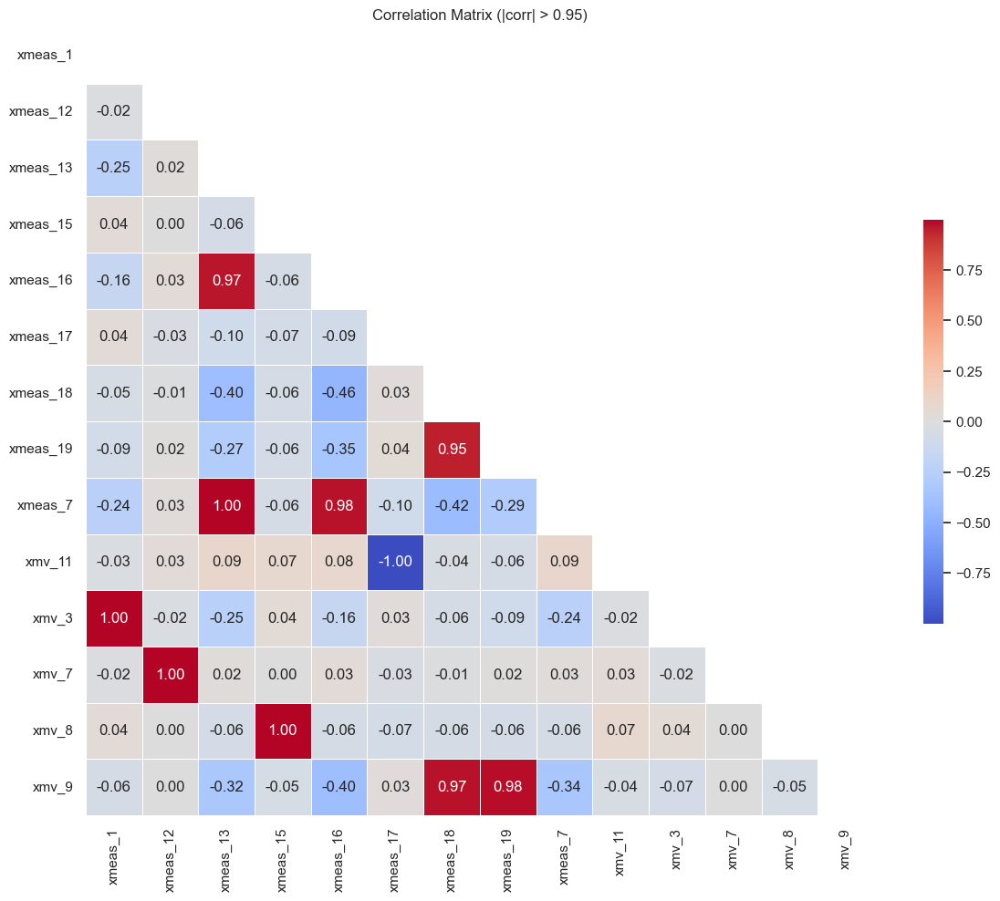

In [35]:
# Plotting the correlation matrix with a threshold
# Set correlation threshold
threshold: float = 0.95

# Load the data into a pandas DataFrame
data: pd.DataFrame = df_ff_training[df_ff_training['simulationRun'] == 1].iloc[:, 3:]

# Calculate correlation matrix
corr: pd.DataFrame = data.corr()

# Remove self-correlation (diagonal only)
corr_abs: pd.DataFrame = corr.abs().copy()
np.fill_diagonal(corr_abs.values, 0.0)



# Identify features with any correlation above threshold
selected_features: set[str] = set(corr_abs.columns[(corr_abs > threshold).any()])
selected_features_list: list[str] = sorted(selected_features)

# Filter correlation matrix to only those features
filtered_corr: pd.DataFrame = corr.loc[selected_features_list, selected_features_list]


# Plot heatmap
sns.set_theme(style='white')
mask: np.ndarray = np.triu(np.ones_like(filtered_corr, dtype=bool))

f, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(
    filtered_corr,
    mask=mask,
    cmap='coolwarm',
    annot=True,
    fmt='.2f',
    square=True,
    linewidths=.5,
    cbar_kws={"shrink": .5}
)
plt.title(f"Correlation Matrix (|corr| > {threshold})")
plt.tight_layout()
plt.show()


In [36]:
# Plotting high-correlation pairs with interactive widgets as Time Series
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import Button, HBox, VBox, Output, Dropdown

# 1. Compute correlation matrix and extract high-correlation pairs
data: pd.DataFrame = df_ff_training[df_ff_training['simulationRun'] == 1].iloc[:, 3:]
corr: pd.DataFrame = data.corr()

# Zero diagonal
corr_abs: pd.DataFrame = corr.abs().copy()
np.fill_diagonal(corr_abs.values, 0.0)

# Threshold
threshold: float = 0.95
high_pairs = [
    (col1, col2, corr.loc[col1, col2])
    for i, col1 in enumerate(corr.columns)
    for j, col2 in enumerate(corr.columns)
    if j > i and isinstance(corr.loc[col1, col2], (float, np.floating)) and abs(corr.loc[col1, col2]) > threshold
]

# 2. Prepare dropdown options
pair_labels: list[str] = [f"{a} - {b} (corr={c:.2f})" for a, b, c in high_pairs]
pair_dict: dict[str, tuple[str, str]] = {label: (a, b) for label, (a, b, _) in zip(pair_labels, high_pairs)}
dropdown = Dropdown(options=pair_labels, description='Pair:')

# 3. Global state
index: int = 0
window_size: int = 150
out = Output()

# 4. Plot logic
def plot_selected_pair(start: int, feature1: str, feature2: str) -> None:
    global out
    series1: pd.Series = data[feature1].reset_index(drop=True)
    series2: pd.Series = data[feature2].reset_index(drop=True)
    mean1, std1 = series1.mean(), series1.std()
    mean2, std2 = series2.mean(), series2.std()

    end: int = min(start + window_size, len(series1))
    x = np.arange(start, end)
    y1 = series1[start:end]
    y2 = series2[start:end]

    with out:
        out.clear_output(wait=True)
        plt.figure(figsize=(12, 5))
        plt.plot(x, y1, label=feature1, color='blue')
        plt.plot(x, y2, label=feature2, color='red')
        
        plt.axhline(mean1, color='blue', linestyle='--')
        plt.axhline(mean1 + std1, color='blue', linestyle=':')
        plt.axhline(mean1 - std1, color='blue', linestyle=':')
        plt.axhline(mean2, color='red', linestyle='--')
        plt.axhline(mean2 + std2, color='red', linestyle=':')
        plt.axhline(mean2 - std2, color='red', linestyle=':')
        
        plt.title(f"{feature1} vs {feature2} [{start}:{end}]")
        plt.xlabel("Time Index")
        plt.ylabel("Value")
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()

# 5. Button callbacks
def on_next_clicked(_):
    global index
    if index + window_size < len(data):
        index += window_size
        f1, f2 = pair_dict[dropdown.value]
        plot_selected_pair(index, f1, f2)

def on_back_clicked(_):
    global index
    if index - window_size >= 0:
        index -= window_size
        f1, f2 = pair_dict[dropdown.value]
        plot_selected_pair(index, f1, f2)

def on_dropdown_change(change):
    global index
    if change['type'] == 'change' and change['name'] == 'value':
        index = 0  # reset on pair change
        f1, f2 = pair_dict[change['new']]
        plot_selected_pair(index, f1, f2)

# Bind events
btn_next = Button(description='Next →')
btn_back = Button(description='← Back')
btn_next.on_click(on_next_clicked)
btn_back.on_click(on_back_clicked)
dropdown.observe(on_dropdown_change)

# Init plot
initial_f1, initial_f2 = pair_dict[dropdown.value]
plot_selected_pair(index, initial_f1, initial_f2)

# Show all widgets
VBox([dropdown, HBox([btn_back, btn_next]), out])


In [37]:
# print the correlation where the upper triangle is greater than 0.90
# This will help identify highly correlated features

corr_matrix = data.corr()

upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape),k=1).astype(bool))

to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 1.0)]
print(len(to_drop))
print(to_drop)

0
[]


# Data preprocessing

# Supervised ML Approach


## Methode that works with LabelEncoded target variable Y

In [38]:
# Fit models to the data
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb

# Create an instance of each algorithm
#logreg = LogisticRegression(max_iter=10000)
#knn = KNeighborsClassifier()
#dt = DecisionTreeClassifier()
#nb = GaussianNB()
#svm = SVC()

rf = RandomForestClassifier()
xg = xgb.XGBClassifier()

# Train the algorithms on the data
# logreg.fit(x_train, y_labeled_train)
# knn.fit(x_train, y_labeled_train)
# dt.fit(x_train, y_labeled_train)
# nb.fit(x_train, y_labeled_train)
#svm.fit(x_train, y_labeled_train)

rf.fit(x_train, y_labeled_train)
xg.fit(x_train, y_labeled_train)


# Use the trained models to make predictions on new data
# y_pred_logreg =logreg.predict(x_test)
# y_pred_dt = dt.predict(x_test)
# y_pred_nb = nb.predict(x_test)
# y_pred_knn = knn.predict(x_test)
#y_pred_svm = svm.predict(x_test) 

y_pred_rf = rf.predict(x_test)
y_pred_xg = xg.predict(x_test)


In [39]:
# import joblib
# joblib.dump(logreg, 'exported-models/logistic_regression_model.pkl')
# joblib.dump(dt, 'exported-models/decision_tree_model.pkl')
# joblib.dump(rf, 'exported-models/random_forest_model.pkl')
# joblib.dump(nb, 'exported-models/naive_bayes_model.pkl')
# joblib.dump(knn, 'exported-models/knn_model.pkl')
# joblib.dump(xg, 'exported-models/xgboost_model.pkl')

### From above analysis, XGB and Random forest Performs well.
### Metrics:

In this series, we will use accuracy as the primary metric for evaluating the performance of the different machine learning algorithms. We will update the table as we evaluate the performance of other algorithms in the subsequently.


Average accuracy score obtained for each method, excluding fault No. 9 and 15 (**No feature were Dropped, all 52 sensor measurements were used**)

| Method                                    |Accuracy  |
|-----------------------------------------  |----------|
| XG Boost                                  |  0.887   |
| Neural Network                            |  0.943   |
| 1D CNN-Timeserise                         |  0.892   |
| LSTM-Timeserise                           |  0.924   |
| ANN+RandomForest                          |  0.936   |

## Methode that works with one hot encoded vector as target variable Y like Neural Network Fault Classification

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 52)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 100)            │         5,300 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 100)            │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 21)             │         2,121 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 57,921 (226.25 KB)

 Trainable params: 57,921 (226.25 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.3627 - loss: 2.1394 - val_accuracy: 0.4712 - val_loss: 1.9453
Epoch 2/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6325 - loss: 1.1083 - val_accuracy: 0.5252 - val_loss: 1.9248
Epoch 3/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6930 - loss: 0.8908 - val_accuracy: 0.5465 - val_loss: 2.0759
Epoch 4/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7211 - loss: 0.7935 - val_accuracy: 0.5838 - val_loss: 2.2438
Epoch 5/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7511 - loss: 0.6979 - val_accuracy: 0.5834 - val_loss: 2.2313
Epoch 6/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7711 - loss: 0.6410 - val_accuracy: 0.5834 - val_loss: 2.5482
Epoch 7/200
119/119 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.7762 - loss: 0.6056 - val_accuracy: 0.6013 - val_loss: 2.5685


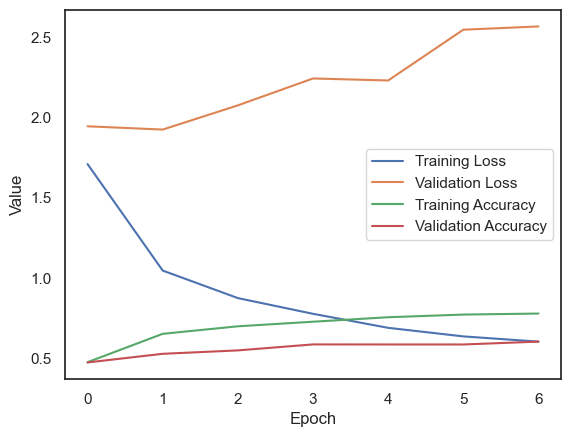

In [40]:
# DNN Model
from keras.layers import Input, Dense
from keras.models import Model
from keras.callbacks import EarlyStopping


# Define input layer
inputs = Input(shape=(x_train.shape[1],))

# Define hidden layer with 16 nodes and ReLU activation function
hidden_layer = Dense(100, activation='selu')(inputs)
hidden_layer = Dense(100, activation='selu')(hidden_layer)
hidden_layer = Dense(100, activation='selu')(hidden_layer)
hidden_layer = Dense(100, activation='selu')(hidden_layer)
hidden_layer = Dense(100, activation='selu')(hidden_layer)
hidden_layer = Dense(100, activation='selu')(hidden_layer)
# Define output layer with softmax activation function for multi-class classification
outputs = Dense(y_one_hot_vector_enc_train.shape[1], activation='softmax')(hidden_layer)

# Define the model
model = Model(inputs=inputs, outputs=outputs)

# Compile the model with binary cross-entropy loss function and Adam optimizer
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Print the summary of the model
model.summary()



# Define early stopping callback to monitor validation loss and stop if it doesn't improve for 5 epochs
early_stop = EarlyStopping(monitor='val_loss', patience=5)

# Train the model with 20 epochs and batch size of 32, using the early stopping callback
history = model.fit(x_train, y_one_hot_vector_enc_train, epochs=200, batch_size=256, validation_data=(x_test, y_one_hot_vector_enc_test), callbacks=[early_stop])

# Plot the training history for loss and accuracy
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Value')
plt.legend()
plt.show()

In [41]:
y_pred_nn = encoder.inverse_transform(model.predict(x_test, verbose=0))
y_true_nn = encoder.inverse_transform(y_one_hot_vector_enc_test)
y_score_nn = model.predict(x_test, verbose=0)

# Evaluating

In [42]:
from typing import Union, List, Dict
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

def compute_classification_scores_per_fault(
    y_true: Union[List[int], np.ndarray],
    y_pred: Union[List[int], np.ndarray]
) -> pd.DataFrame:
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    fault_types = np.unique(y_true[y_true > 0])
    scores_per_fault = {}

    for fault in fault_types:
        y_true_binary = (y_true == fault).astype(int)
        y_pred_binary = (y_pred == fault).astype(int)

        accuracy = accuracy_score(y_true_binary, y_pred_binary)
        precision = precision_score(y_true_binary, y_pred_binary, zero_division=0)
        recall = recall_score(y_true_binary, y_pred_binary, zero_division=0)
        f1 = f1_score(y_true_binary, y_pred_binary, zero_division=0)

        scores_per_fault[fault] = {
            "Accuracy": accuracy,
            "Precision": precision,
            "Recall": recall,
            "F1-score": f1
        }

    return pd.DataFrame(scores_per_fault)


In [43]:
# Plotting classification scores for all models
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sympy import plot

def plot_classification_scores_all_models(
    classification_scores_per_fault_tables: dict[str, dict]
) -> None:
    records = []
    for model_name, score_dict in classification_scores_per_fault_tables.items():
        # Convert dict (fault -> metric dict) to DataFrame
        df = score_dict
        for metric in df.index:
            for fault in df.columns:
                records.append({
                    "Model": model_name,
                    "Fault": fault,
                    "Metric": metric,
                    "Score": df.loc[metric, fault]
                })

    combined_df = pd.DataFrame(records)

    import seaborn as sns
    import matplotlib.pyplot as plt
    g = sns.catplot(
        data=combined_df,
        x="Fault",
        y="Score",
        hue="Model",
        row="Metric",
        kind="bar",
        height=4.5,
        aspect=2,
        palette="Set2",
        ci=None,
        sharey=False
    )

    # Set y-labels explicitly per metric row
    for ax, metric in zip(g.axes.flatten(), combined_df["Metric"].unique()):
        ax.set_ylabel(metric)

    plt.tight_layout()
    plt.show()


In [44]:
# Compute classification scores per fault for each model

from typing import Union
import numpy as np
from sklearn.metrics import confusion_matrix

def macro_false_alarm_rate(
    y_true: Union[list[int], np.ndarray],
    y_pred: Union[list[int], np.ndarray]
) -> float:
    # Compute the confusion matrix for multi-class classification
    cm: np.ndarray = confusion_matrix(y_true, y_pred)

    # Get the number of classes from the confusion matrix shape
    n_classes: int = cm.shape[0]

    # List to store false positive rate (FPR) for each class
    fpr_list: list[float] = []

    # Iterate over each class index (one-vs-rest treatment)
    for i in range(n_classes):
        # False positives for class i: sum of predictions as class i
        # excluding the true positives on the diagonal
        fp: int = cm[:, i].sum() - cm[i, i]

        # True negatives: all samples excluding the positives for class i
        # and the false positives for class i
        tn: int = cm.sum() - (cm[i, :].sum() + cm[:, i].sum() - cm[i, i])

        # Compute FPR: FP / (FP + TN), guard against division by zero
        fpr: float = fp / (fp + tn) if (fp + tn) > 0 else 0.0

        # Append this class’s FPR to the list
        fpr_list.append(fpr)

    # Return the macro-average of FPRs across all classes
    return float(np.mean(fpr_list))



In [45]:
from typing import Union
import numpy as np
from sklearn.metrics import confusion_matrix

def false_alarm_rate_per_class(
    y_true: Union[list[int], np.ndarray],
    y_pred: Union[list[int], np.ndarray]
) -> pd.DataFrame:
    # Compute confusion matrix
    cm: np.ndarray = confusion_matrix(y_true, y_pred)

    # Number of classes
    n_classes: int = cm.shape[0]

    # Dictionary to store FPR per class
    fpr_per_class: dict[int, float] = {}

    # Compute FPR for each class using one-vs-rest
    for i in range(n_classes):
        # False positives for class i
        fp: int = cm[:, i].sum() - cm[i, i]

        # True negatives for class i
        tn: int = cm.sum() - (cm[i, :].sum() + cm[:, i].sum() - cm[i, i])

        # FPR: FP / (FP + TN), avoid division by zero
        fpr: float = fp / (fp + tn) if (fp + tn) > 0 else 0.0

        # Store in dictionary
        fpr_per_class[i] = fpr

    return pd.DataFrame.from_dict(fpr_per_class, orient='index', columns=['FPR'])


In [46]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_fpr_per_class_tables(fpr_tables: dict[str, pd.DataFrame]) -> None:
    for model_name, df in fpr_tables.items():
        plt.figure(figsize=(10, 4))

        df_plot = df.copy()
        df_plot.columns = ['FPR']

        # Dynamic y-axis limit: slightly above max FPR
        max_fpr: float = df_plot['FPR'].max()
        y_max: float = min(1.0, max(0.1, max_fpr * 1.2))  # scale upper limit

        df_plot.plot(kind='bar', legend=False, ax=plt.gca(), color='steelblue')

        plt.title(f'False Positive Rate per Class - {model_name}')
        plt.xlabel('Class')
        plt.ylabel('False Positive Rate')
        plt.ylim(0, y_max)
        plt.xticks(rotation=0)
        plt.grid(axis='y', linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()


In [47]:
from typing import Union
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix

def positive_alarm_rate_per_class(
    y_true: Union[list[int], np.ndarray],
    y_pred: Union[list[int], np.ndarray]
) -> pd.DataFrame:
    cm: np.ndarray = confusion_matrix(y_true, y_pred)
    n_classes: int = cm.shape[0]
    par_per_class: dict[int, float] = {}

    for i in range(n_classes):
        tp: int = cm[i, i]
        fn: int = cm[i, :].sum() - tp
        par: float = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        par_per_class[i] = par

    return pd.DataFrame.from_dict(par_per_class, orient='index', columns=['PAR'])

In [ ]:
# Compute classification metrics avarage per class

from typing import Union
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix

def compute_average_classification_metrics(
    y_true: Union[list[int], np.ndarray],
    y_pred: Union[list[int], np.ndarray]
) -> pd.DataFrame:
    cm: np.ndarray = confusion_matrix(y_true, y_pred)
    n_classes: int = cm.shape[0]

    # Initialize accumulators
    acc_list: list[float] = []
    prec_list: list[float] = []
    rec_list: list[float] = []
    tnr_list: list[float] = []
    fpr_list: list[float] = []
    fnr_list: list[float] = []
    npv_list: list[float] = []
    fdr_list: list[float] = []
    bal_acc_list: list[float] = []
    f1_list: list[float] = []

    for i in range(n_classes):
        tp: int = cm[i, i]
        fn: int = cm[i, :].sum() - tp
        fp: int = cm[:, i].sum() - tp
        tn: int = cm.sum() - (tp + fp + fn)

        # Add safe guards to avoid division by zero
        acc: float = (tp + tn) / (tp + tn + fp + fn) if (tp + tn + fp + fn) > 0 else 0.0
        prec: float = tp / (tp + fp) if (tp + fp) > 0 else 0.0
        rec: float = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        tnr: float = tn / (tn + fp) if (tn + fp) > 0 else 0.0
        fpr: float = fp / (fp + tn) if (fp + tn) > 0 else 0.0
        fnr: float = fn / (tp + fn) if (tp + fn) > 0 else 0.0
        npv: float = tn / (tn + fn) if (tn + fn) > 0 else 0.0
        fdr: float = fp / (tp + fp) if (tp + fp) > 0 else 0.0
        bal_acc: float = (rec + tnr) / 2
        f1: float = (2 * prec * rec) / (prec + rec) if (prec + rec) > 0 else 0.0

        # Accumulate
        acc_list.append(acc)
        prec_list.append(prec)
        rec_list.append(rec)
        tnr_list.append(tnr)
        fpr_list.append(fpr)
        fnr_list.append(fnr)
        npv_list.append(npv)
        fdr_list.append(fdr)
        bal_acc_list.append(bal_acc)
        f1_list.append(f1)

    # Macro-average
    metrics: dict[str, float] = {
        "Accuracy": float(np.mean(acc_list)),
        "Precision": float(np.mean(prec_list)),
        "Recall / Sensitivity / TPR": float(np.mean(rec_list)),
        #"Specificity / TNR": float(np.mean(tnr_list)),
        "F1-Score": float(np.mean(f1_list)),
        "FPR (False Positive Rate)": float(np.mean(fpr_list)),
        #"FNR (False Negative Rate)": float(np.mean(fnr_list)),
        "NPV (Negative Predictive Value)": float(np.mean(npv_list)),
        "FDR (False Discovery Rate)": float(np.mean(fdr_list)),
        "Balanced Accuracy": float(np.mean(bal_acc_list))
    }

    return pd.DataFrame.from_dict(metrics, orient='index', columns=['Value'])


In [ ]:
# Compute classification metrics for each class or fault

from typing import Union
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix

def compute_classification_metrics_per_class(
    y_true: Union[list[int], np.ndarray],
    y_pred: Union[list[int], np.ndarray]
) -> pd.DataFrame:
    cm: np.ndarray = confusion_matrix(y_true, y_pred)
    n_classes: int = cm.shape[0]
    metrics: list[dict] = []

    for i in range(n_classes):
        tp: int = cm[i, i]
        fn: int = cm[i, :].sum() - tp
        fp: int = cm[:, i].sum() - tp
        tn: int = cm.sum() - (tp + fp + fn)

        acc: float = (tp + tn) / (tp + tn + fp + fn) if (tp + tn + fp + fn) > 0 else 0.0
        prec: float = tp / (tp + fp) if (tp + fp) > 0 else 0.0
        rec: float = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        tnr: float = tn / (tn + fp) if (tn + fp) > 0 else 0.0
        fpr: float = fp / (fp + tn) if (fp + tn) > 0 else 0.0
        fnr: float = fn / (tp + fn) if (tp + fn) > 0 else 0.0
        npv: float = tn / (tn + fn) if (tn + fn) > 0 else 0.0
        fdr: float = fp / (tp + fp) if (tp + fp) > 0 else 0.0
        bal_acc: float = (rec + tnr) / 2
        f1: float = (2 * prec * rec) / (prec + rec) if (prec + rec) > 0 else 0.0

        metrics.append({
            "Class": i,
            "Accuracy": acc,
            "Precision": prec,
            "Recall / Sensitivity / TPR": rec,
            #"Specificity / TNR": tnr,
            "FPR (False Positive Rate)": fpr,
            #"FNR (False Negative Rate)": fnr,
            "NPV (Negative Predictive Value)": npv,
            "FDR (False Discovery Rate)": fdr,
            "Balanced Accuracy": bal_acc,
            "F1-Score": f1
        })

    return pd.DataFrame(metrics).set_index("Class")


In [49]:
# Evaluate models and compute metrics
from turtle import pos
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
models_results: list[dict] = []
arl_tables: dict[str, pd.DataFrame] = {}
delay_tables: dict[str, pd.DataFrame] = {}
classification_scores_per_fault_tables: dict[str, pd.DataFrame] = {}
fpr_per_class_tables: dict[str, pd.DataFrame] = {}
positive_alarm_rate_per_class_table: dict[str, pd.DataFrame] = {}

def evaluate_model(name: str, y_true, y_pred, y_score=None) -> None:
    acc: float = accuracy_score(y_true, y_pred)
    prec: float = precision_score(y_true, y_pred, average='macro', zero_division=0)
    rec: float = recall_score(y_true, y_pred, average='macro', zero_division=0)
    f1: float = f1_score(y_true, y_pred, average='macro', zero_division=0)
    far: float = macro_false_alarm_rate(y_true, y_pred)
    models_results.append({
        'Model': name,
        'Accuracy': acc,
        'Precision': prec,
        'Recall': rec,
        'F1-Score': f1,
        'False Alarm Rate': far, # or False Positive Rate (FPR)
    })

    arl_tables[name] = compute_arl_per_fault(y_true, y_pred)
    delay_tables[name] = compute_first_detection_delay(y_true, y_pred)
    classification_scores_per_fault_tables[name] = compute_classification_scores_per_fault(y_true, y_pred)
    fpr_per_class_tables[name] = false_alarm_rate_per_class(y_true, y_pred)
    positive_alarm_rate_per_class_table[name] = positive_alarm_rate_per_class(y_true, y_pred)


In [50]:
# Evaluate
evaluate_model('Random Forest', y_labeled_test, y_pred_rf)
evaluate_model('XGBoost', y_labeled_test, y_pred_xg)
evaluate_model('Neural Net', y_true_nn, y_pred_nn, y_score=y_score_nn)


print_per_model_tables()
print_summary_table()


ARL per Fault – Random Forest
╒═════════╤════════╤════════╕
│   Fault │   ARL0 │   ARL1 │
╞═════════╪════════╪════════╡
│    1.00 │ inf    │ 144.50 │
├─────────┼────────┼────────┤
│    2.00 │ inf    │ 152.00 │
├─────────┼────────┼────────┤
│    3.00 │   5.23 │   1.50 │
├─────────┼────────┼────────┤
│    4.00 │ inf    │ 143.00 │
├─────────┼────────┼────────┤
│    5.00 │  62.14 │   1.00 │
├─────────┼────────┼────────┤
│    6.00 │ inf    │ 140.00 │
├─────────┼────────┼────────┤
│    7.00 │ inf    │ 140.00 │
├─────────┼────────┼────────┤
│    8.00 │ 519.00 │ 154.50 │
├─────────┼────────┼────────┤
│    9.00 │   3.52 │   4.50 │
├─────────┼────────┼────────┤
│   10.00 │  24.23 │  81.00 │
├─────────┼────────┼────────┤
│   11.00 │  83.52 │  70.00 │
├─────────┼────────┼────────┤
│   12.00 │ inf    │ 145.00 │
├─────────┼────────┼────────┤
│   13.00 │ inf    │ 180.50 │
├─────────┼────────┼────────┤
│   14.00 │ inf    │ 141.00 │
├─────────┼────────┼────────┤
│   15.00 │   1.92 │   1.00 │
├────────

In [ ]:
# Print classification scores tables per fault for each model

results_per_model: dict[str, pd.DataFrame] = {
    "Random Forest": compute_classification_metrics_per_class(y_labeled_test, y_pred_rf),
    "XGBoost": compute_classification_metrics_per_class(y_labeled_test, y_pred_xg),
    "Neural Net": compute_classification_metrics_per_class(y_labeled_test, y_pred_nn),
}

# loop through each model and print the classification metrics
for model_name, df in results_per_model.items():
    # Add an "Average" row at the end of the DataFrame
    average_row = df.mean(axis=0).to_frame().T
    average_row.index = ['Average']
    df = pd.concat([df, average_row])
    print(f"Classification Metrics for {model_name}:")
    print(tabulate(df, headers='keys', tablefmt='grid'))
    print("\n") 

Classification Metrics for Random Forest:
+---------+------------+-------------+------------------------------+---------------------+-----------------------------+-----------------------------+-----------------------------------+------------------------------+---------------------+------------+
|         |   Accuracy |   Precision |   Recall / Sensitivity / TPR |   Specificity / TNR |   FPR (False Positive Rate) |   FNR (False Negative Rate) |   NPV (Negative Predictive Value) |   FDR (False Discovery Rate) |   Balanced Accuracy |   F1-Score |
+=========+============+=============+==============================+=====================+=============================+=============================+===================================+==============================+=====================+============+
| 0       |   0.937411 |    0.143546 |                    0.0632979 |            0.981117 |                 0.018883    |                    0.936702 |                          0.954438 |         

In [ ]:
# 
metrics = compute_average_classification_metrics(y_labeled_test, y_pred_xg)
print("Classification Metrics:")
print(tabulate(metrics, headers='keys', tablefmt='grid', showindex=True))

Classification Metrics:
+---------------------------------+----------+
|                                 |    Value |
+=================================+==========+
| Accuracy                        | 0.965236 |
+---------------------------------+----------+
| Precision                       | 0.744387 |
+---------------------------------+----------+
| Recall / Sensitivity / TPR      | 0.63498  |
+---------------------------------+----------+
| Specificity / TNR               | 0.981749 |
+---------------------------------+----------+
| F1-Score                        | 0.676163 |
+---------------------------------+----------+
| FPR (False Positive Rate)       | 0.018251 |
+---------------------------------+----------+
| FNR (False Negative Rate)       | 0.36502  |
+---------------------------------+----------+
| NPV (Negative Predictive Value) | 0.981595 |
+---------------------------------+----------+
| FDR (False Discovery Rate)      | 0.255613 |
+---------------------------------+-

In [ ]:
# Plot per class metrics comparison for all models

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def plot_per_class_metrics_comparison(model_metrics: dict[str, pd.DataFrame]) -> None:
    model_names: list[str] = list(model_metrics.keys())
    classes: list[int] = model_metrics[model_names[0]].index.tolist()
    metrics: list[str] = model_metrics[model_names[0]].columns.tolist()

    for class_id in classes:
        # Transpose to shape [metric x model]
        plot_df = pd.DataFrame({
            model: df.loc[class_id] for model, df in model_metrics.items()
        })
        plot_df = plot_df.T  # [models x metrics]

        # Transpose to group by metric
        plot_df = plot_df.T  # [metrics x models]

        ax = plot_df.plot(kind='bar', figsize=(20, 8), width=0.75)
        ax.set_title(f"Fault Class {class_id} – Model Comparison per Metric")
        ax.set_xlabel("Metric")
        ax.set_ylabel("Score")
        ax.set_ylim(0, 1)
        ax.set_xticks(np.arange(len(metrics)))
        ax.set_xticklabels(metrics, rotation=45, ha='right')

        # Add fine horizontal grid lines every 0.05
        ax.yaxis.set_ticks(np.arange(0, 1.05, 0.05))
        ax.grid(axis='y', linestyle='--', alpha=0.5)

        ax.legend(title="Model", bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

    # Average per model
    avg_df = pd.DataFrame({
        model: df.mean(axis=0) for model, df in model_metrics.items()
    })
    avg_df = avg_df.T  # [models x metrics]
    avg_df = avg_df.T  # [metrics x models]

    ax = avg_df.plot(kind='bar', figsize=(20, 8), width=0.75)
    ax.set_title("Average Metrics Across All Classes – Model Comparison")
    ax.set_xlabel("Metric")
    ax.set_ylabel("Average Score")
    ax.set_ylim(0, 1)
    ax.set_xticks(np.arange(len(metrics)))
    ax.set_xticklabels(metrics, rotation=45, ha='right')

    ax.yaxis.set_ticks(np.arange(0, 1.05, 0.1))
    ax.grid(axis='y', linestyle='--', alpha=0.5)

    ax.legend(title="Model", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


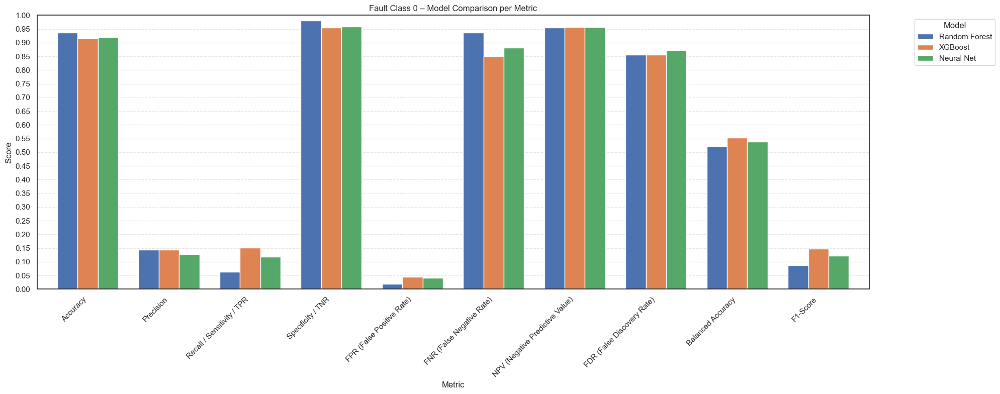

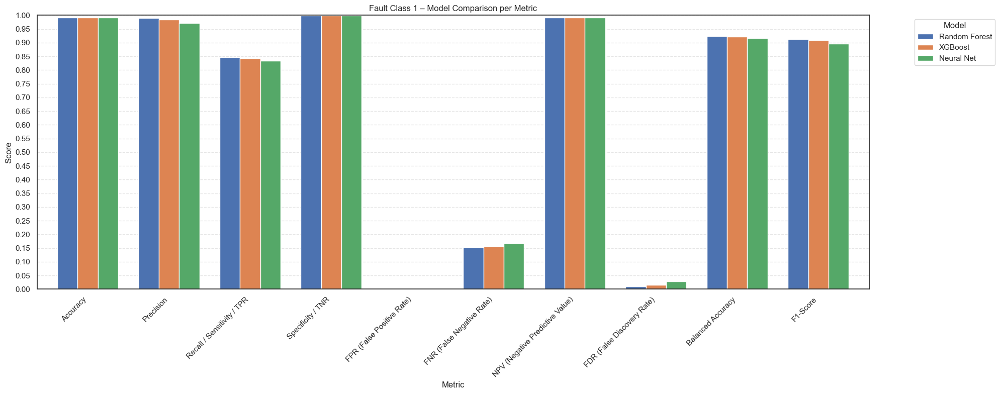

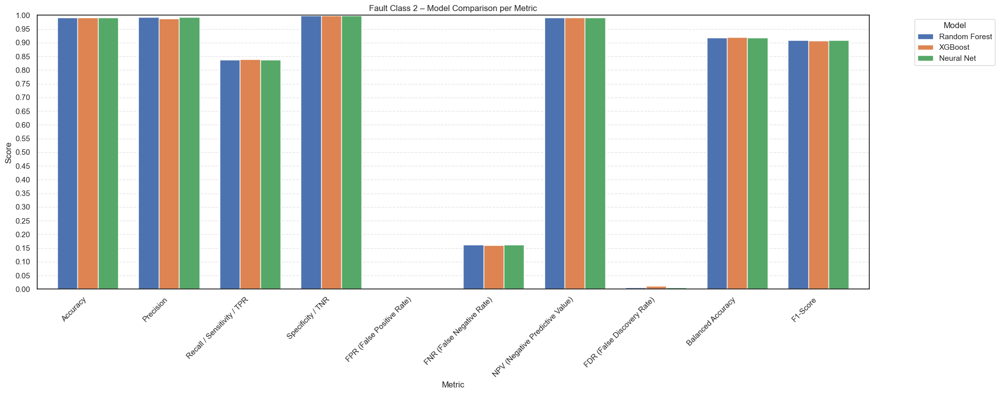

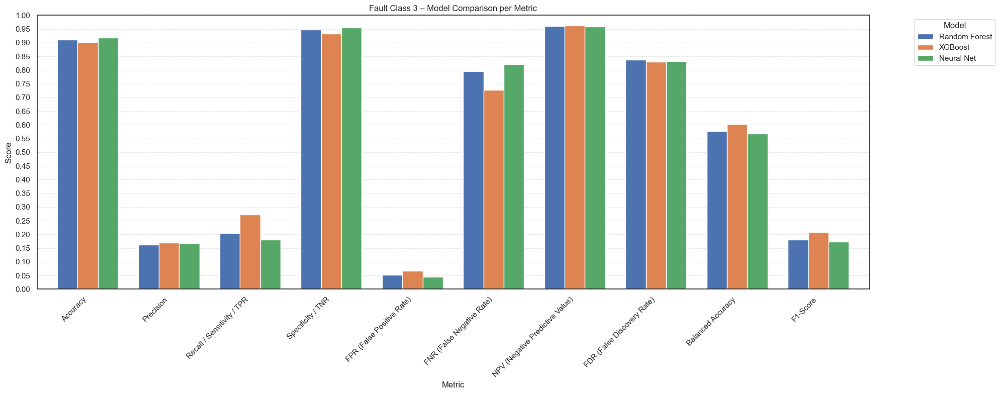

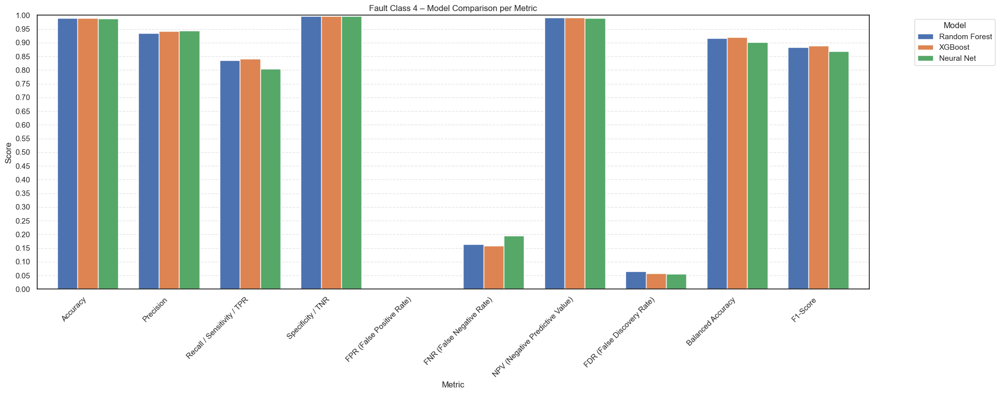

...

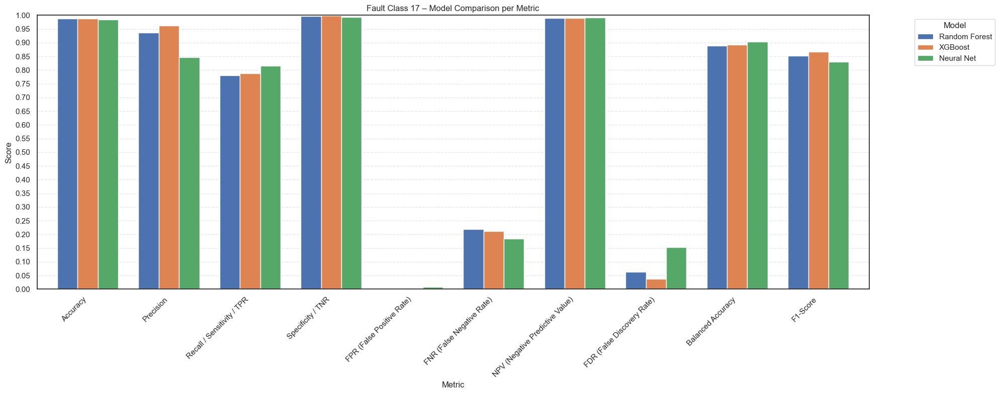

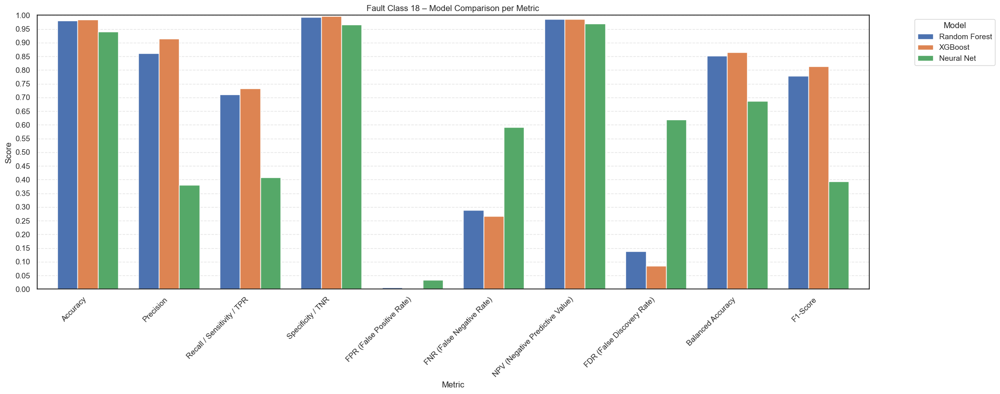

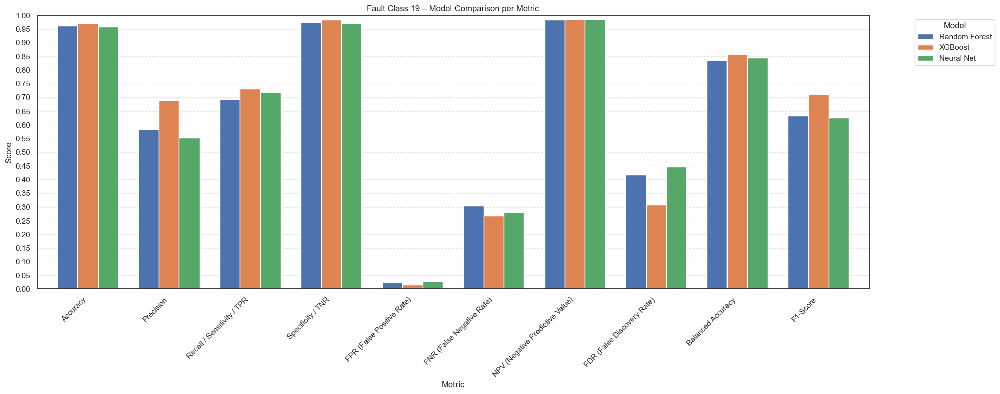

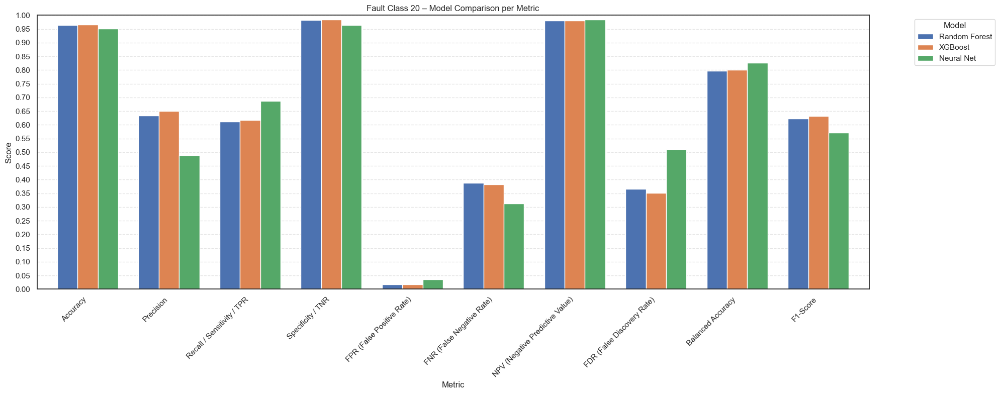

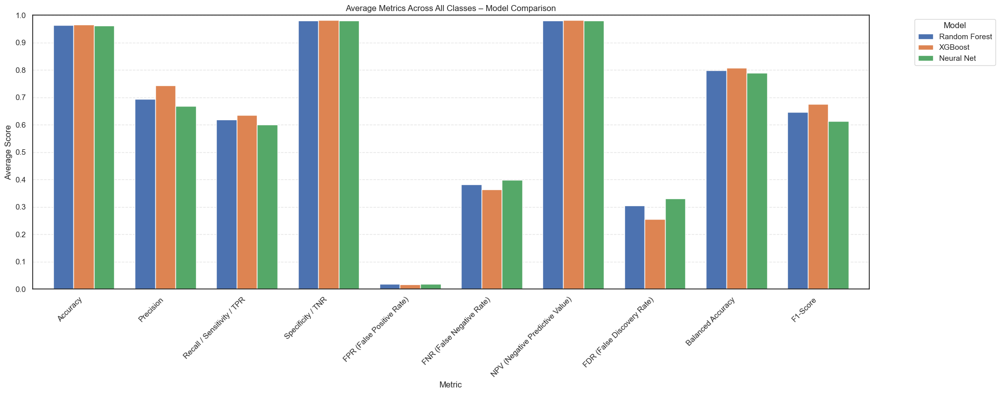

In [87]:
# Compute per-class metrics for each model and plot comparison
results_per_model: dict[str, pd.DataFrame] = {
    "Random Forest": compute_classification_metrics_per_class(y_labeled_test, y_pred_rf),
    "XGBoost": compute_classification_metrics_per_class(y_labeled_test, y_pred_xg),
    "Neural Net": compute_classification_metrics_per_class(y_labeled_test, y_pred_nn),
}

plot_per_class_metrics_comparison(results_per_model)


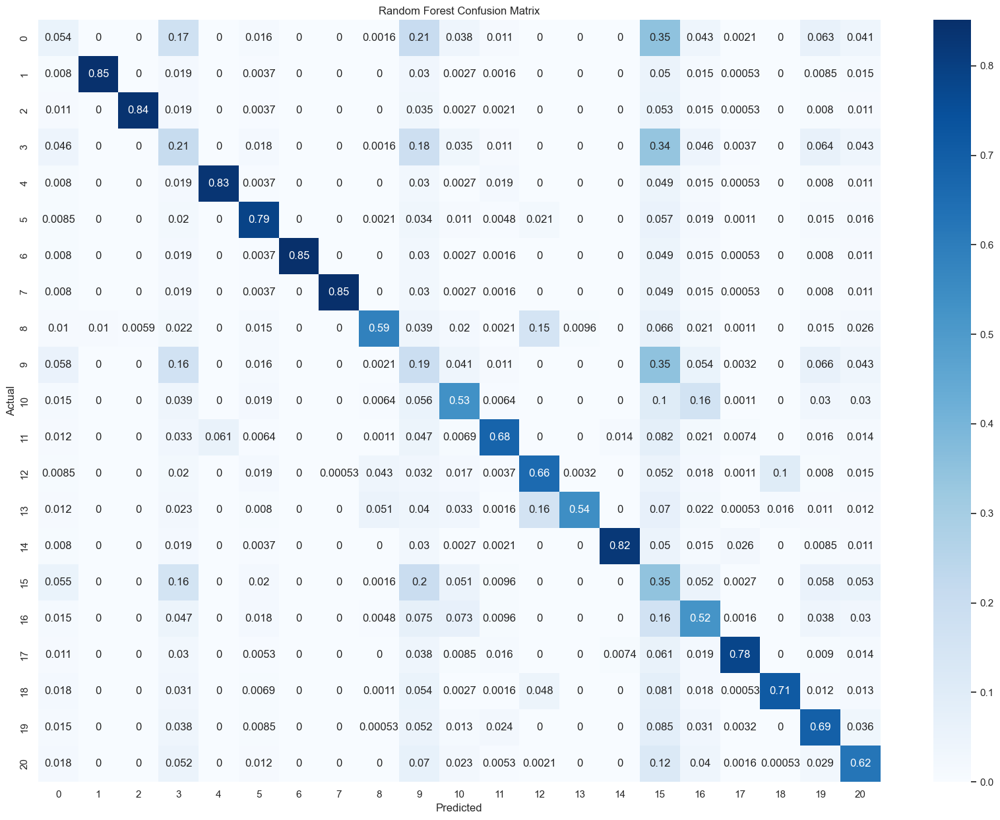

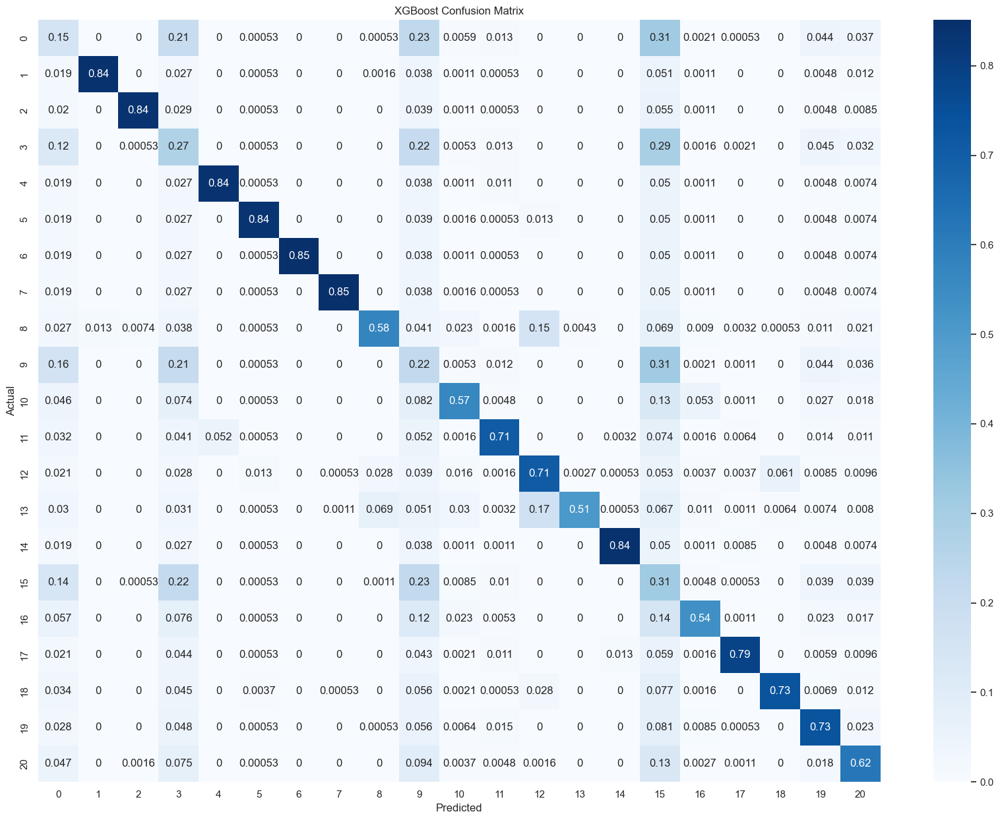

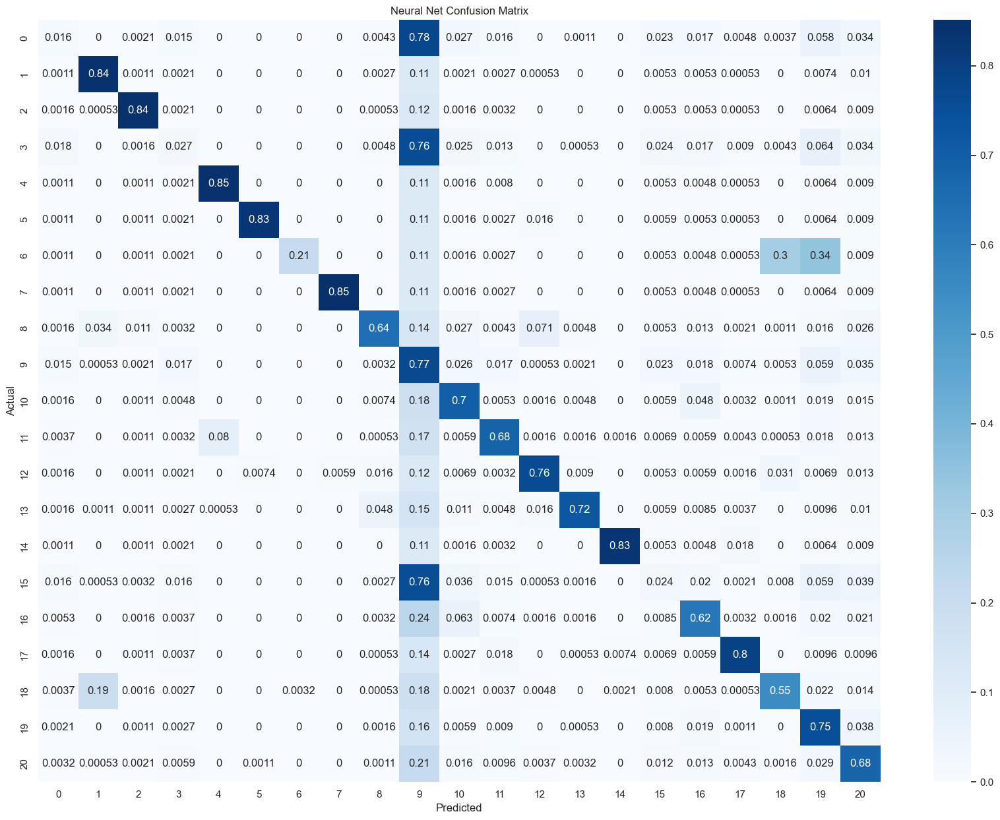

In [ ]:
plot_all_confusion_matrices({
    'Random Forest': (y_labeled_test, y_pred_rf),
    'XGBoost': (y_labeled_test, y_pred_xg),
    'Neural Net': (y_true_nn, y_pred_nn)
})

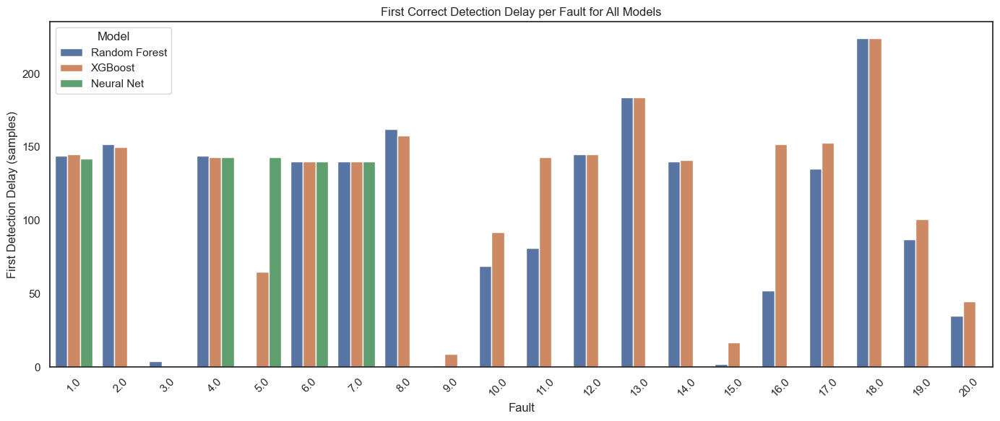

In [ ]:
plot_combined_detection_delay(delay_tables)

**FBR**

Lower FPR means fewer false alarms for that specific class

High FPR in class 15, for example, means the model often wrongly classifies normal data (or other faults) as class 15

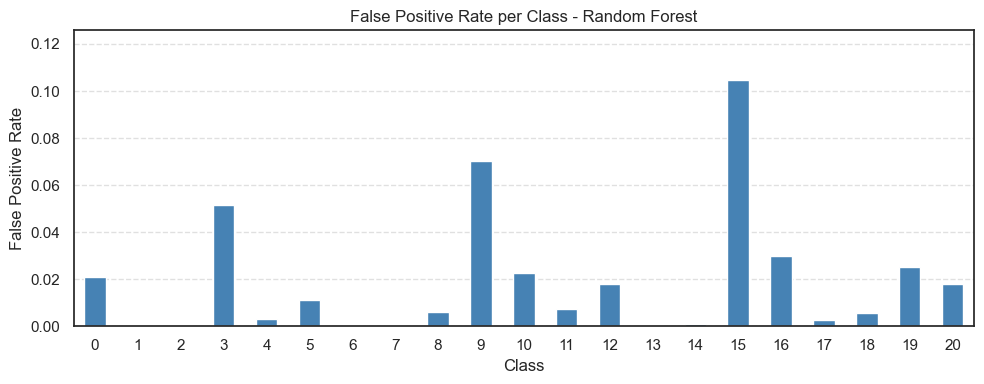

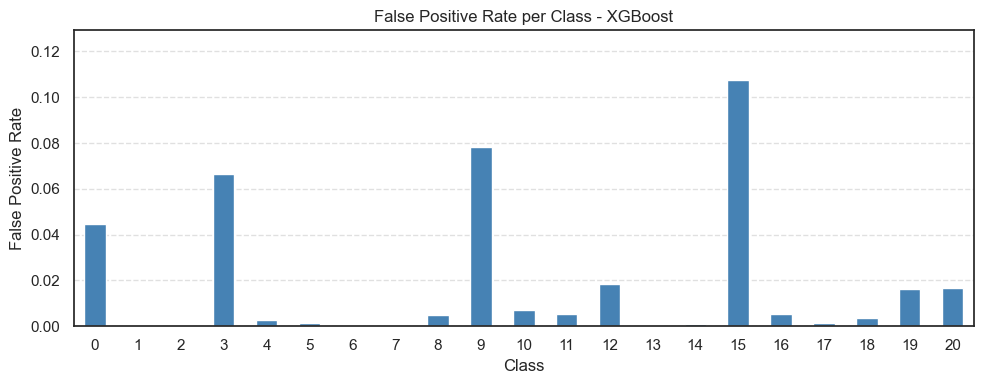

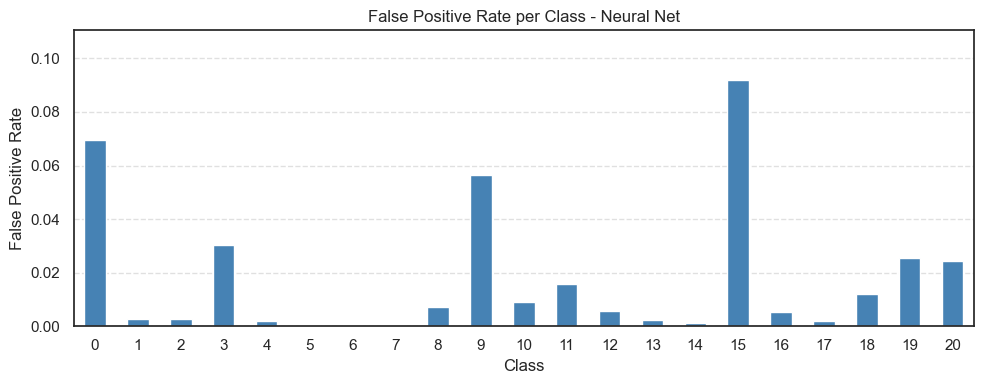

In [ ]:
plot_fpr_per_class_tables(fpr_per_class_tables)

# fpr_per_class_tables is a dict of model name -> DataFrame (index: class, column: FPR)
# Concatenate all into one DataFrame for display
all_fpr_df = []
for model, df in fpr_per_class_tables.items():
    temp = df.copy()
    temp['Model'] = model
    temp['Class'] = temp.index
    all_fpr_df.append(temp.reset_index(drop=True))
all_fpr_df = pd.concat(all_fpr_df, ignore_index=True)

#print(tabulate(all_fpr_df, headers='keys', tablefmt='grid', showindex=False, floatfmt=".4f"))

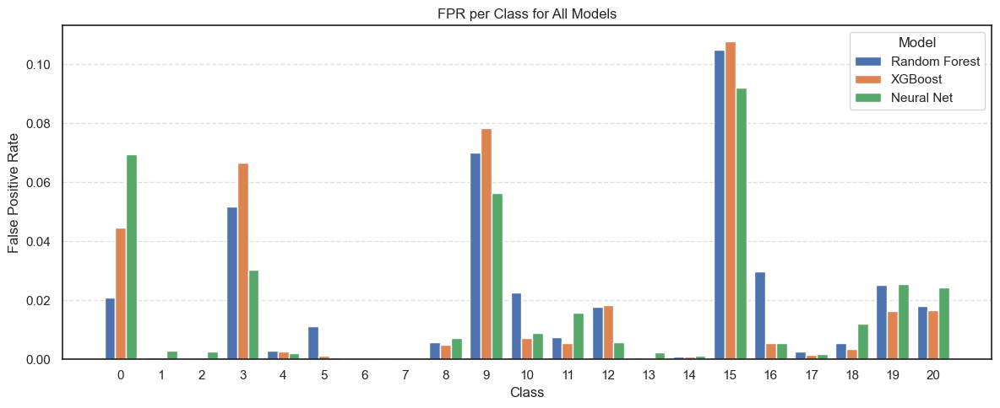

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

def plot_fpr_per_class_combined(fpr_tables: dict[str, pd.DataFrame]) -> None:
    # Assume all DataFrames have the same index (class labels)
    class_labels: list = fpr_tables[next(iter(fpr_tables))].index.tolist()
    model_names: list = list(fpr_tables.keys())
    
    # Prepare combined DataFrame
    combined_df: pd.DataFrame = pd.DataFrame(index=class_labels)

    for model_name, df in fpr_tables.items():
        combined_df[model_name] = df['FPR']

    # Plotting
    n_classes: int = len(class_labels)
    n_models: int = len(model_names)
    bar_width: float = 0.8 / n_models
    x = np.arange(n_classes)

    plt.figure(figsize=(12, 5))
    for i, model in enumerate(model_names):
        plt.bar(
            x + i * bar_width,
            combined_df[model],
            width=bar_width,
            label=model
        )

    plt.xlabel("Class")
    plt.ylabel("False Positive Rate")
    plt.title("FPR per Class for All Models")
    plt.xticks(x + bar_width * (n_models - 1) / 2, class_labels, rotation=0)
    plt.legend(title="Model")
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

plot_fpr_per_class_combined(fpr_per_class_tables)

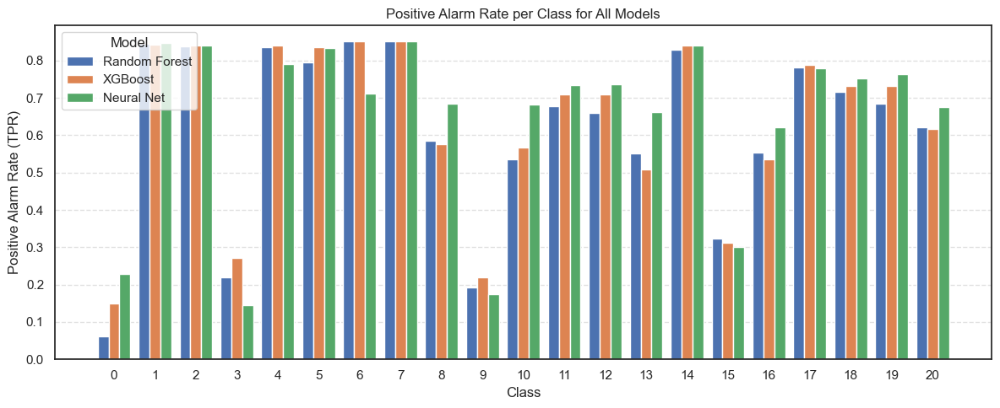

In [ ]:
# Plotting Positive Alarm Rate (PAR) per class for all models

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def plot_par_per_class_combined(par_tables: dict[str, pd.DataFrame]) -> None:
    class_labels: list = par_tables[next(iter(par_tables))].index.tolist()
    model_names: list = list(par_tables.keys())
    
    combined_df: pd.DataFrame = pd.DataFrame(index=class_labels)
    for model_name, df in par_tables.items():
        combined_df[model_name] = df['PAR']

    n_classes: int = len(class_labels)
    n_models: int = len(model_names)
    bar_width: float = 0.8 / n_models
    x = np.arange(n_classes)

    plt.figure(figsize=(12, 5))
    for i, model in enumerate(model_names):
        plt.bar(
            x + i * bar_width,
            combined_df[model],
            width=bar_width,
            label=model
        )

    plt.xlabel("Class")
    plt.ylabel("Positive Alarm Rate (TPR)")
    plt.title("Positive Alarm Rate per Class for All Models")
    plt.xticks(x + bar_width * (n_models - 1) / 2, class_labels, rotation=0)
    plt.legend(title="Model")
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()
    
plot_par_per_class_combined(positive_alarm_rate_per_class_table)


**ARL**
- Low ARL₀ is bad for practical use: causes many unnecessary alarms.

- Low ARL₁ is good if it's accompanied by high ARL₀ — i.e., a sharp and correct detection only when needed.

- Low ARL₀ and ARL₁ mean the feature triggers many false alarms and detects faults too early or too easily. It's likely unstable or noisy, not reliable alone.

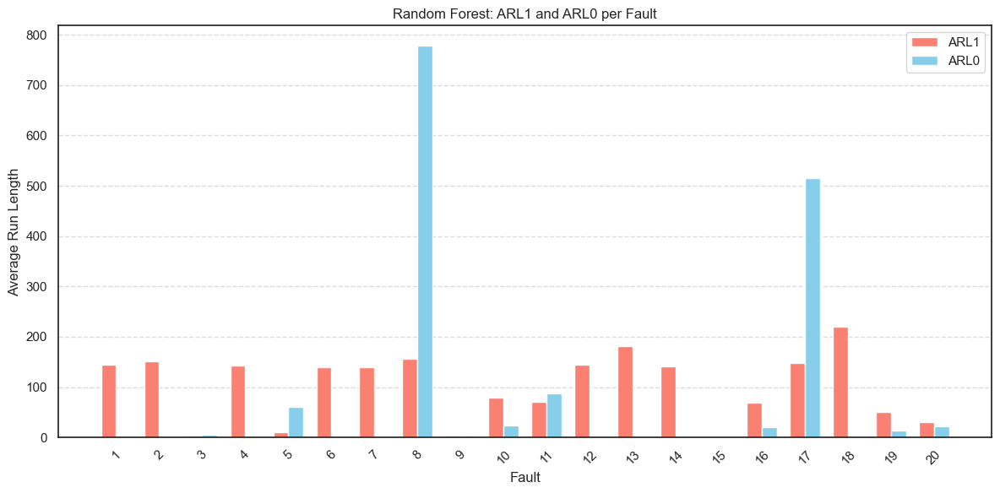

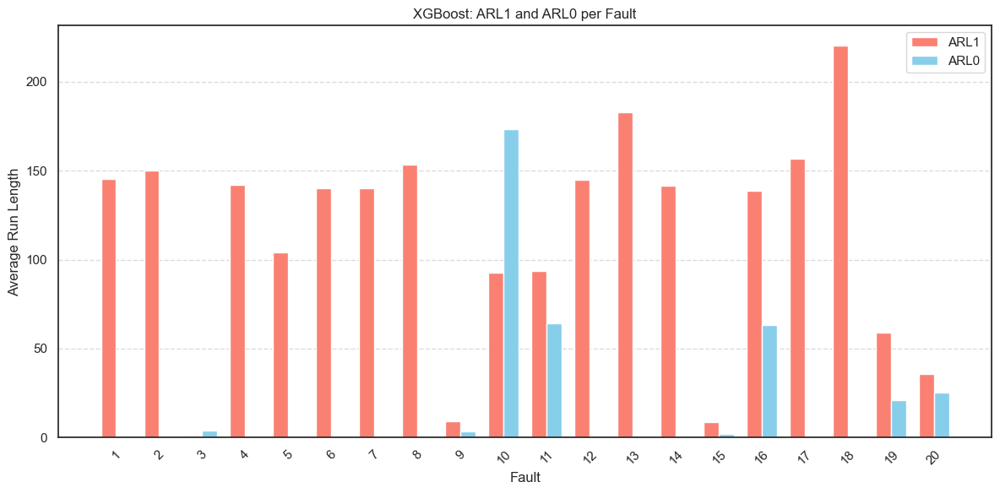

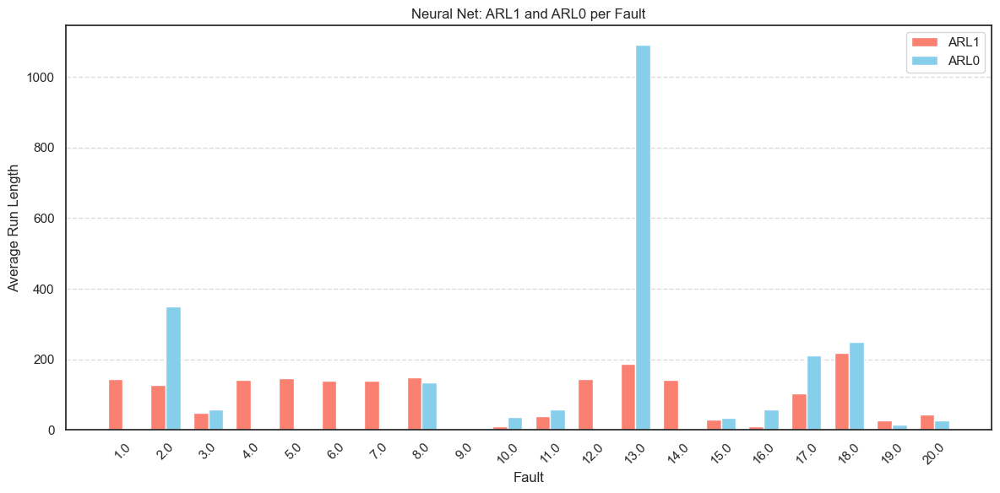

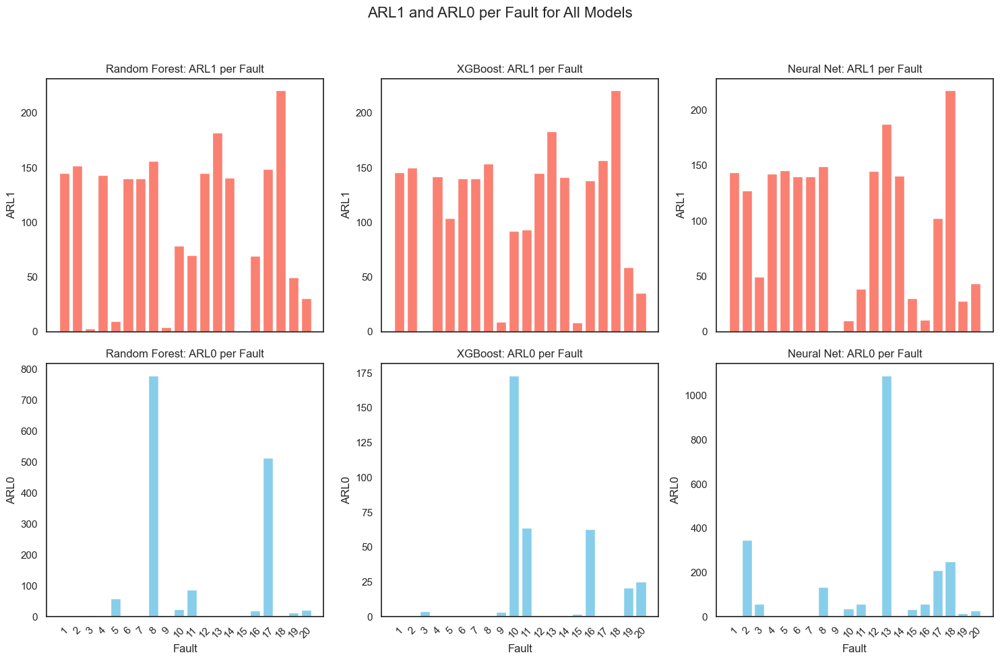

In [ ]:
plot_arl_bars_per_model(arl_tables)
plot_combined_arl_bars(arl_tables)

**Metric**
* **Accuracy**: Overall correctness → (TP + TN) / total
* **Precision**: Correct alarms among all alarms → TP / (TP + FP)
* **Recall**: Found faults among all actual faults → TP / (TP + FN)
* **F1 Score**: Balance between precision and recall → 2·(P·R)/(P+R)
* **False Alarm Rate**: Wrong alarms in normal data → FP / (FP + TN)


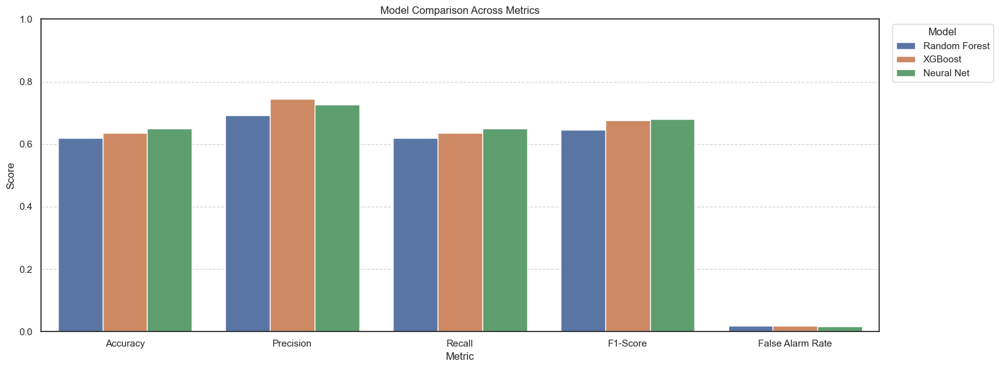

In [ ]:
plot_models_metrics_compareing()

/var/folders/sz/qdyj3ffd5rxg1vjk8d82pkkm0000gp/T/ipykernel_76085/942006712.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  g = sns.catplot(


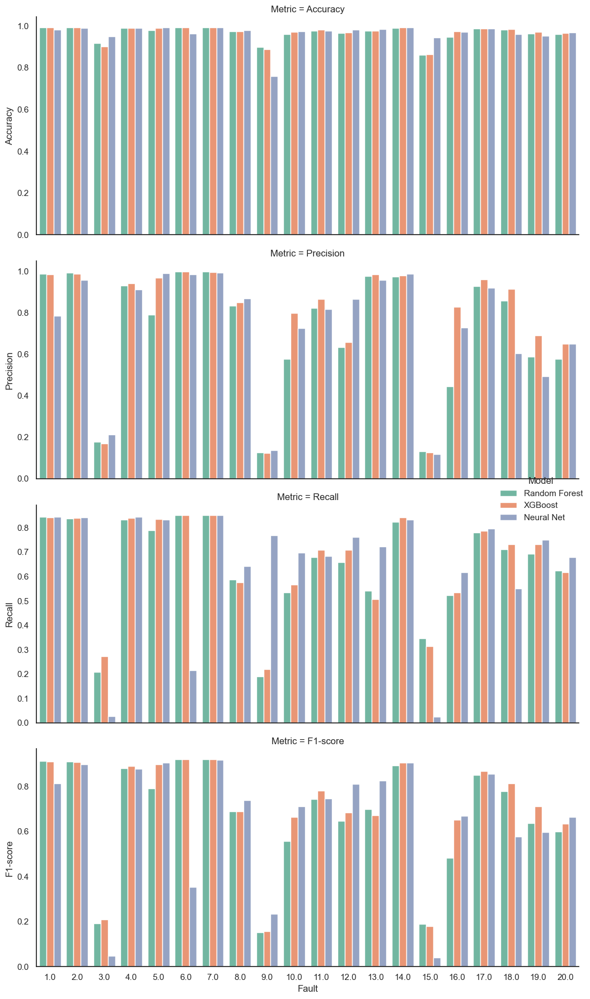

In [ ]:
plot_classification_scores_all_models(classification_scores_per_fault_tables)